In [91]:
import importlib
import pickle

import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split

import utils
importlib.reload(utils)

from utils import (
    calculate_accuracy_by_gender_and_ethnicity,
    create_dataset,
    evaluate_and_predict,
    find_prototype_and_criticism,
    plot_accuracy_comparison_by_group,
    plot_comparison_metric,
    plot_confusion_matrix,
    prepare_comparison_data,
    prepare_dataframe,
    predict_xai,
)

In [75]:
np.random.seed(42)
tf.random.set_seed(42)

In [76]:
DATASET_DIR = "datasets/utkface"
IMG_DIM = 200
INPUT_SHAPE = (IMG_DIM, IMG_DIM, 3)

FIXED_KERNEL_SIZE = (3, 3)
MIN_DENSE_UNITS = 16
NUM_AGE_CLASSES = 9

In [77]:
# Only process information for age class <= 8 (80-89) removing 200~ rows

df_full = prepare_dataframe(DATASET_DIR)
df = df_full[df_full['Age_Class'] <= 8].copy()

shuffled_df = df.sample(frac=1, random_state=42).reset_index(drop=True)

In [78]:
shuffled_df

,Image_Path,Age,Gender,Ethnicity,Age_Class
0,datasets/utkface/35_0_0_20170117191042138.jpg....,35,0,0,3
1,datasets/utkface/4_1_4_20161221193345109.jpg.c...,4,1,4,0
2,datasets/utkface/28_0_3_20170119211807137.jpg....,28,0,3,2
3,datasets/utkface/16_1_0_20170104013358122.jpg....,16,1,0,1
4,datasets/utkface/3_1_0_20170109194247387.jpg.c...,3,1,0,0
...,...,...,...,...,...
23531,datasets/utkface/32_1_0_20170117134737646.jpg....,32,1,0,3
23532,datasets/utkface/68_1_1_20170113012709282.jpg....,68,1,1,6
23533,datasets/utkface/25_1_1_20170112192328981.jpg....,25,1,1,2
23534,datasets/utkface/16_0_0_20170110232714508.jpg....,16,0,0,1


In [79]:
# Train-test split, used for evaluating final model
df_train, df_test = train_test_split(shuffled_df, test_size=0.2, random_state=42)

# Train-val split, used for evaluating intermediate model
df_train_tune, df_val_tune = train_test_split(df_train, test_size=0.2, random_state=42)

In [80]:
# both models have batch_size 64

with open("models/best_hyperparameters.pkl", 'rb') as f:
    loaded_best_hps = pickle.load(f)
    batch_size = loaded_best_hps.values['batch_size']

batch_size

64

In [81]:
test_ds = create_dataset(
    df_test['Image_Path'],
    df_test['Age_Class'],
    batch_size=batch_size,
    img_height=200,
    img_width=200,
    is_training=False
)

results = {}

In [82]:
results['base'], df_base_results, base_model = evaluate_and_predict(
    model_path="models/base_model_trained.h5",
    model_name="Base Model",
    test_dataset=test_ds,
    true_labels_df=df_test.copy()
)

/home/hylke/miniconda3/envs/ageclassification/lib/python3.10/site-packages/keras/src/optimizers/base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


Classification Report:
              precision    recall  f1-score   support

         0-9       0.85      0.96      0.90       609
       10-19       0.73      0.38      0.50       309
       20-29       0.70      0.82      0.75      1502
       30-39       0.48      0.48      0.48       872
       40-49       0.51      0.24      0.33       450
       50-59       0.47      0.58      0.52       484
       60-69       0.38      0.36      0.37       249
       70-79       0.37      0.27      0.31       138
       80-89       0.52      0.36      0.42        95

    accuracy                           0.62      4708
   macro avg       0.56      0.49      0.51      4708
weighted avg       0.61      0.62      0.60      4708



In [83]:
print(f"Base Model Accuracy: {results['base']['classification_report']['accuracy']:.{4}f}")

Base Model Accuracy: 0.6170


In [84]:
results['balanced'], df_balanced_results, balanced_model = evaluate_and_predict(
    model_path="models/class_weight_model_trained.h5",
    model_name="Class Weight Model",
    test_dataset=test_ds,
    true_labels_df=df_test.copy()
)

/home/hylke/miniconda3/envs/ageclassification/lib/python3.10/site-packages/keras/src/optimizers/base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


Classification Report:
              precision    recall  f1-score   support

         0-9       0.95      0.89      0.92       609
       10-19       0.57      0.68      0.62       309
       20-29       0.76      0.67      0.71      1502
       30-39       0.44      0.42      0.43       872
       40-49       0.35      0.46      0.39       450
       50-59       0.46      0.50      0.48       484
       60-69       0.34      0.25      0.29       249
       70-79       0.29      0.33      0.31       138
       80-89       0.47      0.63      0.54        95

    accuracy                           0.58      4708
   macro avg       0.51      0.54      0.52      4708
weighted avg       0.60      0.58      0.59      4708



In [85]:
print(f"Base Model Accuracy: {results['balanced']['classification_report']['accuracy']:.{4}f}")

Base Model Accuracy: 0.5833


In [86]:
df_balanced_results

,Image_Path,Age,Gender,Ethnicity,Age_Class,Predicted_Age_Class,Confidence
12961,datasets/utkface/45_0_3_20170119200707996.jpg....,45,0,3,4,4,0.591884
17794,datasets/utkface/7_0_2_20161219190327212.jpg.c...,7,0,2,0,0,0.619974
8951,datasets/utkface/31_1_3_20170104223321247.jpg....,31,1,3,3,2,0.527787
911,datasets/utkface/36_0_0_20170104173013523.jpg....,36,0,0,3,4,0.554429
15180,datasets/utkface/23_1_1_20170102233446754.jpg....,23,1,1,2,3,0.406235
...,...,...,...,...,...,...,...
3,datasets/utkface/16_1_0_20170104013358122.jpg....,16,1,0,1,1,0.633695
12498,datasets/utkface/27_1_1_20170117013821300.jpg....,27,1,1,2,2,0.487438
19313,datasets/utkface/26_1_0_20170116235853558.jpg....,26,1,0,2,2,0.450258
13987,datasets/utkface/12_1_0_20170109204206273.jpg....,12,1,0,1,3,0.271724


In [17]:
report_dict_base = results['base']['classification_report']
report_dict_balanced = results['balanced']['classification_report']

In [18]:
num_classes = 9
class_names = [f"{i*10}-{i*10+9}" for i in range(num_classes)]

In [19]:
df_base = pd.DataFrame(report_dict_base).transpose()
df_balanced = pd.DataFrame(report_dict_balanced).transpose()

support_threshold = 500 
minority_filter = df_base['support'] < support_threshold
# remove accuracy
class_filter = ~df_base.index.isin(['accuracy'])
final_filter = minority_filter & class_filter

df_minority_base = df_base[final_filter]
df_minority_balanced = df_balanced[final_filter]

metrics_to_show = ['precision', 'recall', 'f1-score', 'support']
df_minority_base = df_minority_base[metrics_to_show].add_suffix('_Base')
df_minority_balanced = df_minority_balanced[metrics_to_show].add_suffix('_Balanced')

df_comparison = pd.concat([df_minority_base, df_minority_balanced], axis=1)

column_order = []
for metric in ['precision', 'recall', 'f1-score']:
    column_order.extend([f'{metric}_Base', f'{metric}_Balanced'])

column_order.append('support_Base')
df_comparison = df_comparison[column_order]
df_comparison = df_comparison.rename(columns={'support_Base': 'support'})

if df_comparison.empty:
    print(f"No classes found with support below threshold {support_threshold}")
else:
    print(f"\n--- Comparison for Minority Classes (< {support_threshold} support) ---")
    print(df_comparison.round(4))


--- Comparison for Minority Classes (< 500 support) ---
       precision_Base  precision_Balanced  recall_Base  recall_Balanced  \
10-19          0.7329              0.5657       0.3819           0.6828   
40-49          0.5143              0.3457       0.2400           0.4556   
50-59          0.4653              0.4594       0.5826           0.5021   
60-69          0.3797              0.3405       0.3614           0.2530   
70-79          0.3700              0.2930       0.2681           0.3333   
80-89          0.5231              0.4651       0.3579           0.6316   

       f1-score_Base  f1-score_Balanced  support  
10-19         0.5021             0.6188    309.0  
40-49         0.3273             0.3931    450.0  
50-59         0.5174             0.4798    484.0  
60-69         0.3704             0.2903    249.0  
70-79         0.3109             0.3119    138.0  
80-89         0.4250             0.5357     95.0  


In [20]:
support_threshold_value = 500
df_comparison_processed, minority_classes_list = prepare_comparison_data(
    report_dict_base,
    report_dict_balanced,
    support_threshold_value
)

In [21]:
df_comparison_processed

,precision_Base,precision_Balanced,recall_Base,recall_Balanced,f1-score_Base,f1-score_Balanced,support
0-9,0.846154,0.953982,0.957307,0.885057,0.898305,0.918228,609.0
10-19,0.732919,0.565684,0.381877,0.682848,0.502128,0.618768,309.0
20-29,0.695039,0.759970,0.820905,0.672437,0.752747,0.713529,1502.0
30-39,0.484988,0.435142,0.481651,0.423165,0.483314,0.429070,872.0
40-49,0.514286,0.345700,0.240000,0.455556,0.327273,0.393097,450.0
50-59,0.465347,0.459357,0.582645,0.502066,0.517431,0.479763,484.0
60-69,0.379747,0.340541,0.361446,0.253012,0.370370,0.290323,249.0
70-79,0.370000,0.292994,0.268116,0.333333,0.310924,0.311864,138.0
80-89,0.523077,0.465116,0.357895,0.631579,0.425000,0.535714,95.0


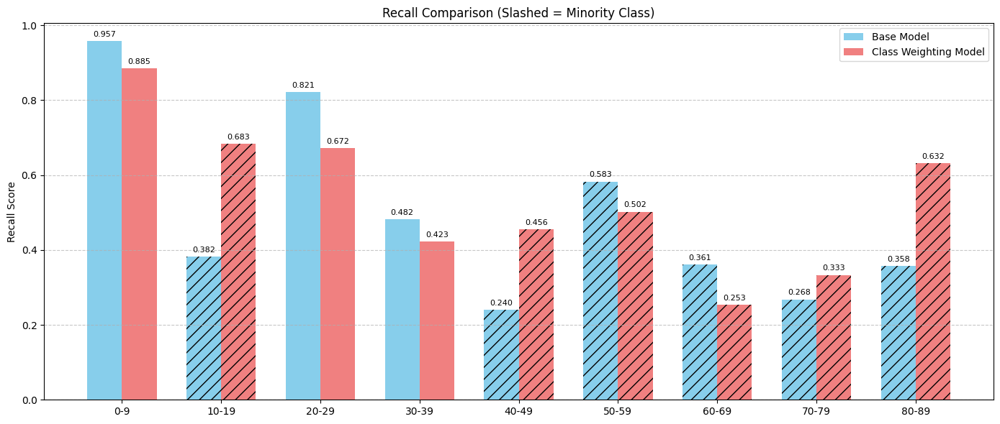

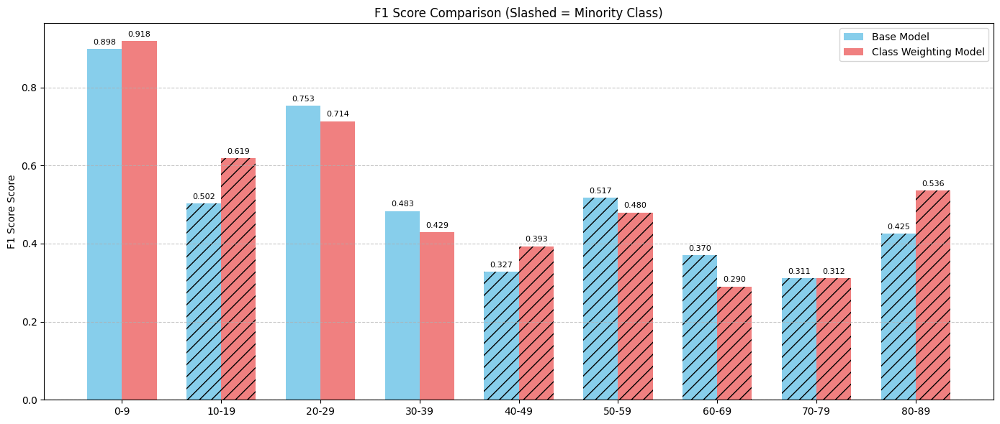

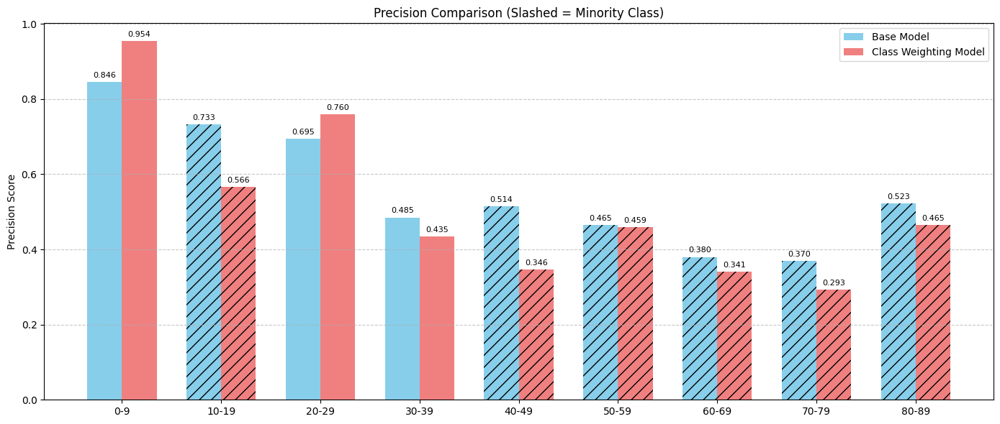

In [22]:
plot_comparison_metric(df_comparison_processed, 'recall', minority_classes_list)
plot_comparison_metric(df_comparison_processed, 'f1-score', minority_classes_list)
plot_comparison_metric(df_comparison_processed, 'precision', minority_classes_list)

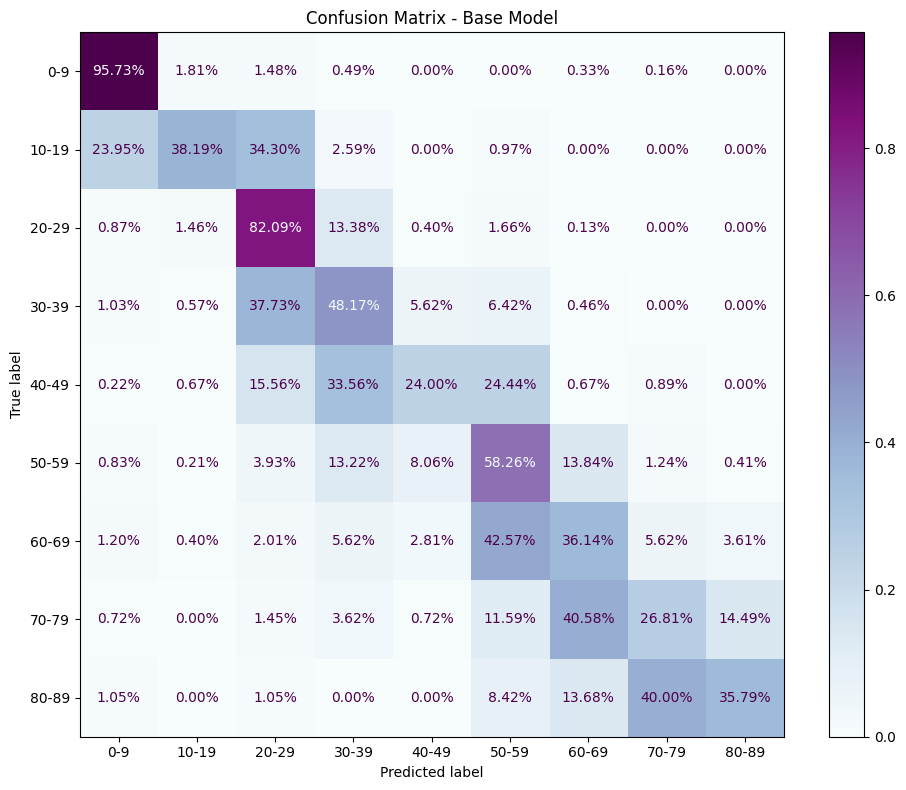

In [23]:
plot_confusion_matrix(df_base_results, 'Confusion Matrix - Base Model')

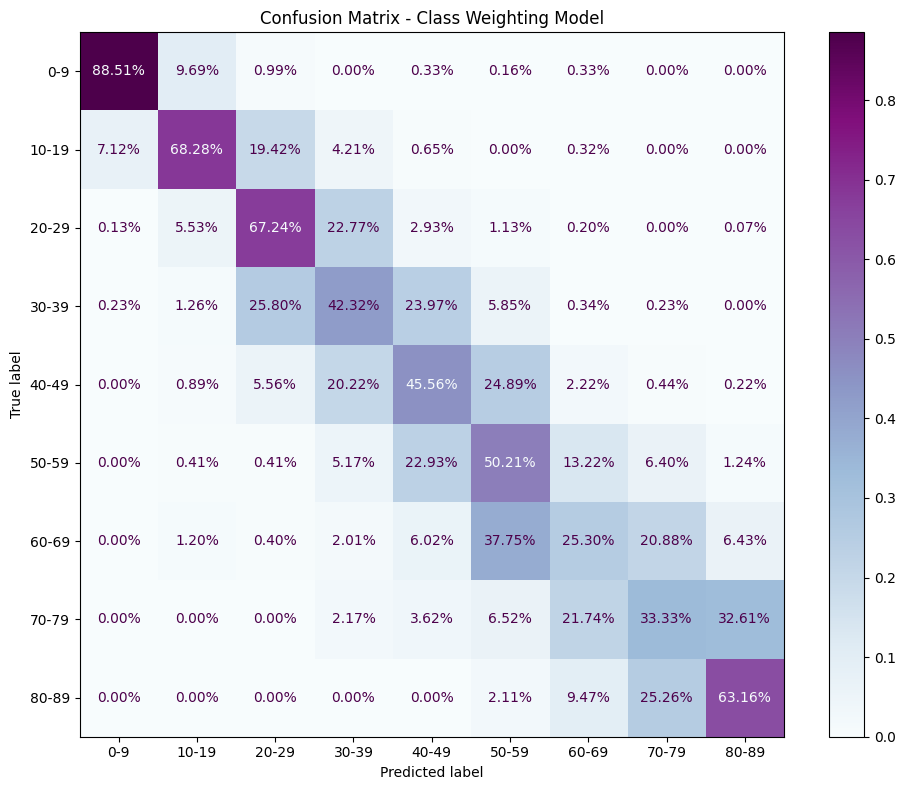

In [24]:
plot_confusion_matrix(df_balanced_results, 'Confusion Matrix - Class Weighting Model')

In [25]:
accuracy_base = calculate_accuracy_by_gender_and_ethnicity(df_base_results)
accuracy_balanced = calculate_accuracy_by_gender_and_ethnicity(df_balanced_results)

Combined Accuracy by Gender and Ethnicity:
  Gender_Label Ethnicity_Label  Base Model  Class Weighting Model  Support
0         Male           White       0.541                  0.496     1109
1         Male           Black       0.581                  0.563      442
2         Male           Asian       0.713                  0.683      303
3         Male          Indian       0.608                  0.542      474
4         Male          Others       0.669                  0.607      145
5       Female           White       0.552                  0.562      924
6       Female           Black       0.624                  0.564      436
7       Female           Asian       0.794                  0.767      369
8       Female          Indian       0.706                  0.675      323
9       Female          Others       0.787                  0.705      183


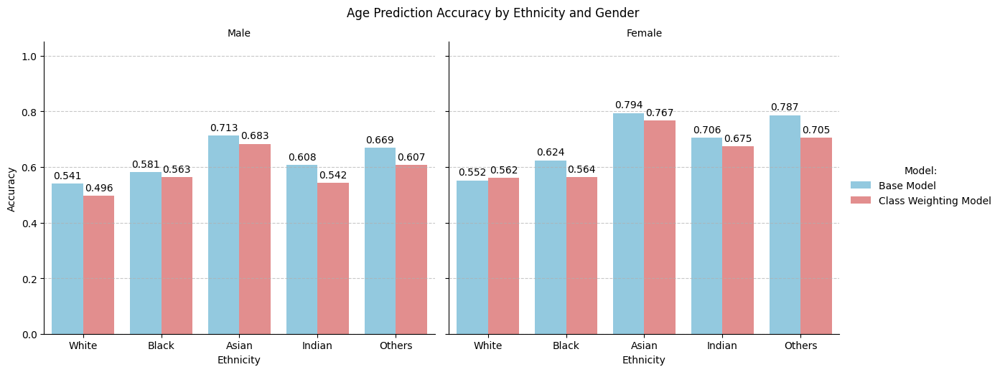

In [26]:
plot_accuracy_comparison_by_group(accuracy_base, accuracy_balanced)

Top 3 Predictions:
Age Range 0-9: 100.000% (0.9999996423721313)
Age Range 10-19: 0.000% (4.013499790289643e-07)
Age Range 20-29: 0.000% (7.015016345590652e-11)

Final Age Group Prediction:
Age Group: 0-9
Cumulative Confidence: 100.000% (0.9999996423721313)


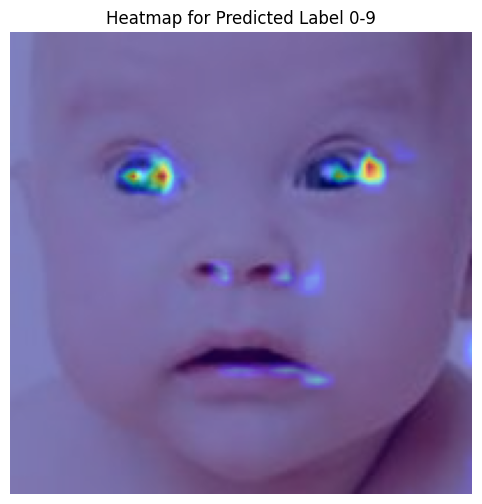

In [27]:
predict_xai(base_model, "datasets/utkface/1_0_0_20161219204759412.jpg.chip.jpg", plot_heatmap=True)

In [88]:
gender_map = [0, 1]
ethnicity_map = [0, 1, 2, 3, 4]
age_group_map = [2, 4]

for gender in gender_map:
    for ethnicity in ethnicity_map:
        for age_group in age_group_map:
            find_prototype_and_criticism(df_balanced_results.copy(), gender, ethnicity, age_group, "balanced_model_prototypes_and_criticisms.csv", True)

INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/29_0_0_20170117190157234.jpg.chip.jpg
Age: 29
Age_Class: 20-29
Predicted_Age_Class: 20-29 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/29_0_0_20170117180920915.jpg.chip.jpg
Age: 29
Age_Class: 20-29
Predicted_Age_Class: 60-69 (Diff: 4)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 4 (40-49)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/44_0_0_20170105172858549.jpg.chip.jpg
Age: 44
Age_Class: 40-49
Predicted_Age_Class: 40-49 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/42_0_0_20170116205352497.jpg.chip.jpg
Age: 42
Age_Class: 40-49
Predicted_Age_Class: 80-89 (Diff: 4)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 1 (Black), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/24_0_1_20170113133945657.jpg.chip.jpg
Age: 24
Age_Class: 20-29
Predicted_Age_C

In [89]:
for gender in gender_map:
    for ethnicity in ethnicity_map:
        for age_group in age_group_map:
            find_prototype_and_criticism(df_base_results.copy(), gender, ethnicity, age_group, "base_model_prototypes_and_criticisms.csv", True)

INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/20_0_0_20170117134052589.jpg.chip.jpg
Age: 20
Age_Class: 20-29
Predicted_Age_Class: 20-29 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/26_0_0_20170117003329930.jpg.chip.jpg
Age: 26
Age_Class: 20-29
Predicted_Age_Class: 50-59 (Diff: 3)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 4 (40-49)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/45_0_0_20170117185253753.jpg.chip.jpg
Age: 45
Age_Class: 40-49
Predicted_Age_Class: 40-49 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/42_0_0_20170116221906957.jpg.chip.jpg
Age: 42
Age_Class: 40-49
Predicted_Age_Class: 70-79 (Diff: 3)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 1 (Black), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/27_0_1_20170113133630265.jpg.chip.jpg
Age: 27
Age_Class: 20-29
Predicted_Age_C

Top 3 Predictions:
Age Range 0-9: 100.00% (0.9999996)
Age Range 10-19: 0.00% (0.0000004)
Age Range 20-29: 0.00% (0.0000000)

Final Age Group Prediction:
Age Group: 0-9
Cumulative Confidence: 100.00% (0.9999996)


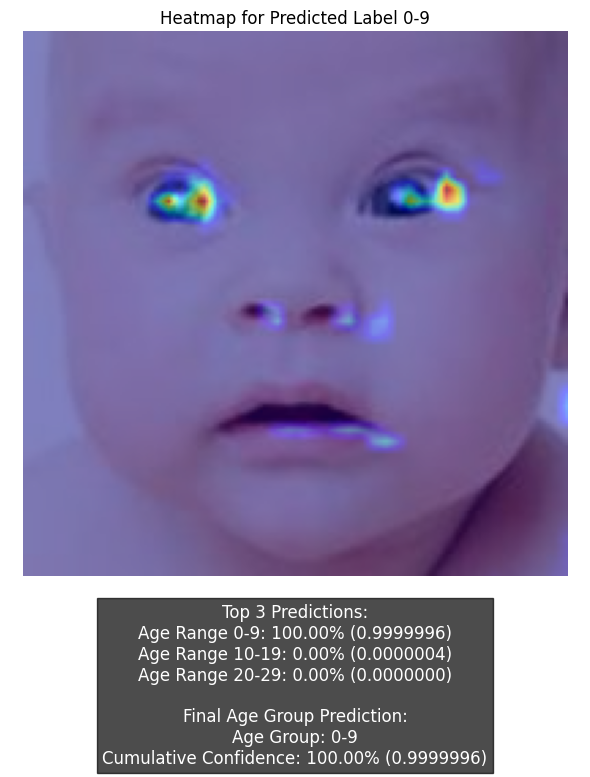

In [62]:
predict_xai(base_model, "datasets/utkface/1_0_0_20161219204759412.jpg.chip.jpg", plot_heatmap=True, save_file="images/test_heatmap_output.jpg")

Top 3 Predictions:
Age Range 20-29: 97.00% (0.9700425)
Age Range 30-39: 2.03% (0.0202694)
Age Range 10-19: 0.93% (0.0093399)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 97.00% (0.9700425)


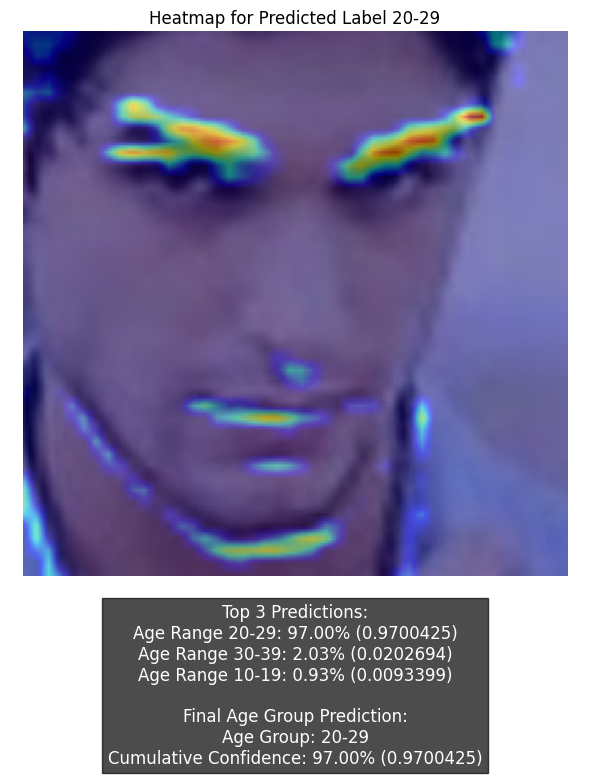

Top 3 Predictions:
Age Range 50-59: 21.58% (0.2157646)
Age Range 60-69: 20.73% (0.2073438)
Age Range 70-79: 17.10% (0.1710249)

Final Age Group Prediction:
Age Group: 20-89
Cumulative Confidence: 93.37% (0.9337090)


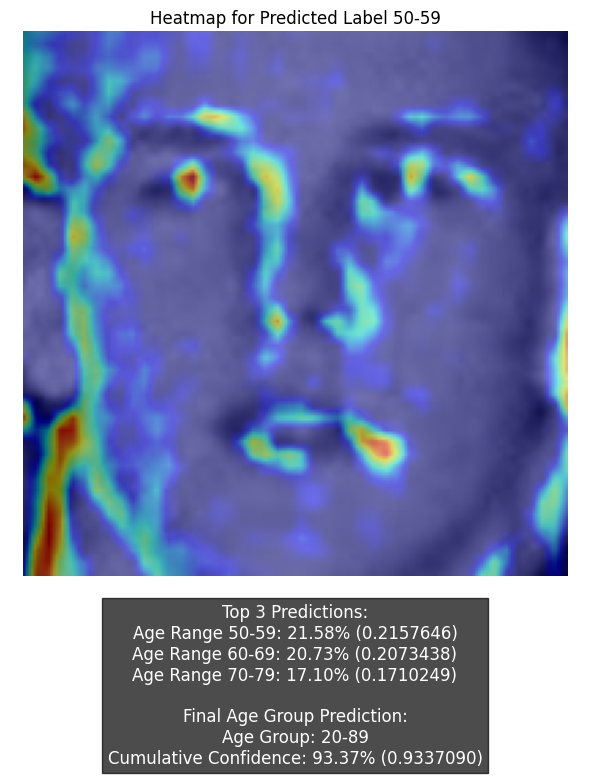

Top 3 Predictions:
Age Range 40-49: 58.73% (0.5873397)
Age Range 30-39: 25.95% (0.2595237)
Age Range 50-59: 14.32% (0.1431724)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 99.00% (0.9900358)


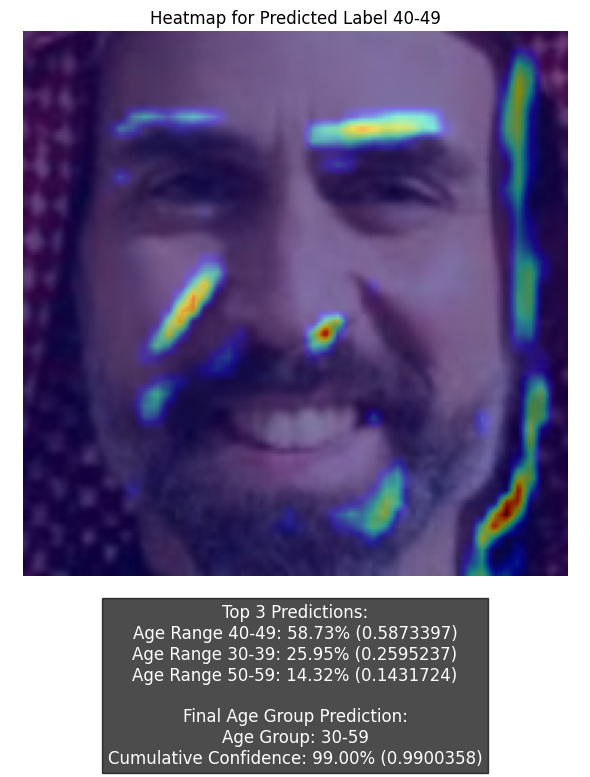

Top 3 Predictions:
Age Range 70-79: 28.51% (0.2851087)
Age Range 60-69: 26.31% (0.2631103)
Age Range 80-89: 20.66% (0.2065908)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 91.03% (0.9103400)


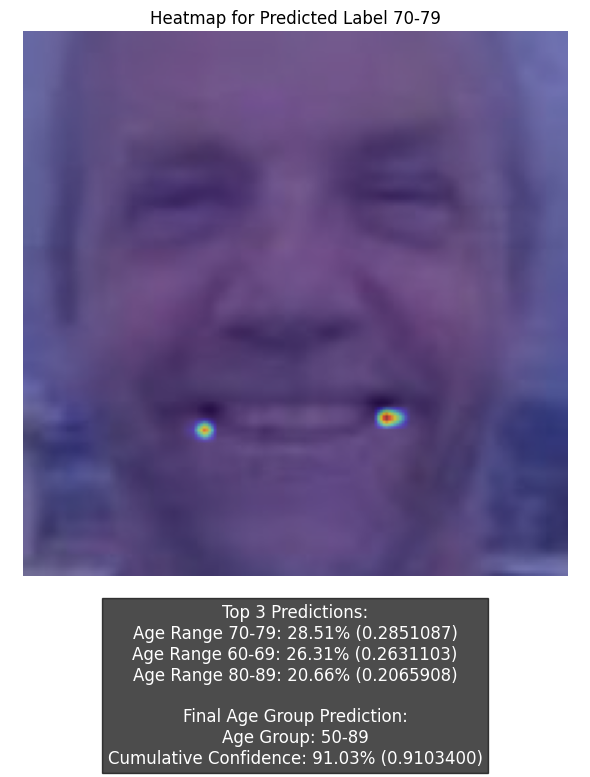

Top 3 Predictions:
Age Range 20-29: 92.59% (0.9258655)
Age Range 30-39: 5.95% (0.0594747)
Age Range 10-19: 1.38% (0.0137695)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 92.59% (0.9258655)


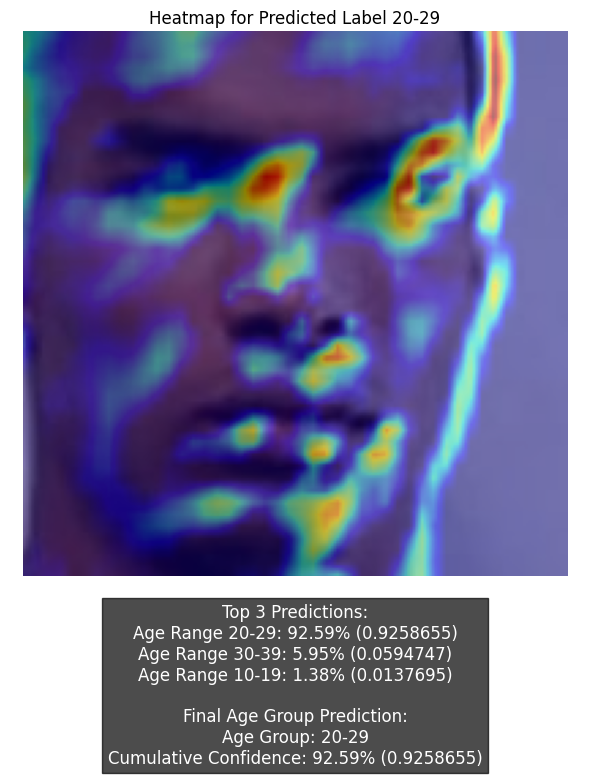

Top 3 Predictions:
Age Range 50-59: 28.64% (0.2864307)
Age Range 40-49: 15.93% (0.1593461)
Age Range 60-69: 15.23% (0.1522913)

Final Age Group Prediction:
Age Group: 10-89
Cumulative Confidence: 93.08% (0.9308338)


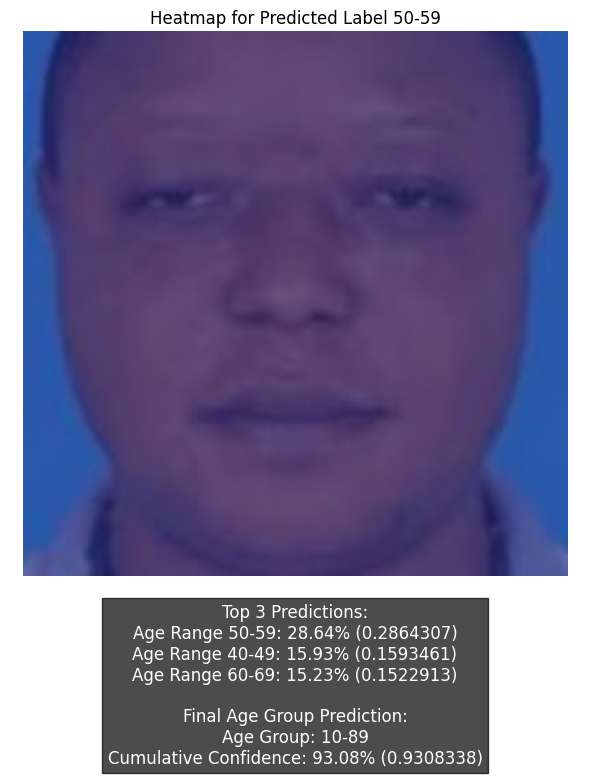

Top 3 Predictions:
Age Range 40-49: 44.47% (0.4446985)
Age Range 30-39: 31.18% (0.3117725)
Age Range 50-59: 16.49% (0.1648906)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 92.14% (0.9213616)


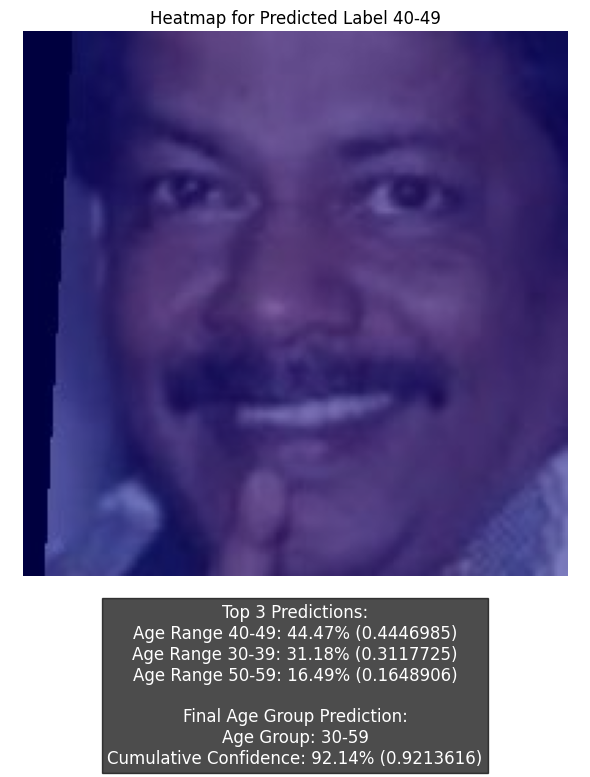

Top 3 Predictions:
Age Range 70-79: 28.10% (0.2809525)
Age Range 80-89: 27.83% (0.2783314)
Age Range 60-69: 24.17% (0.2417304)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 93.14% (0.9313764)


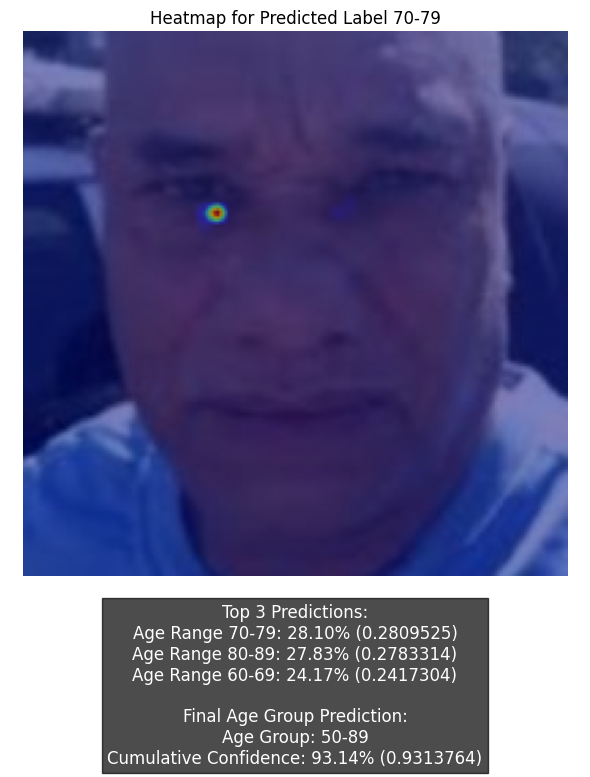

Top 3 Predictions:
Age Range 20-29: 97.63% (0.9762906)
Age Range 30-39: 2.14% (0.0214403)
Age Range 10-19: 0.21% (0.0020560)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 97.63% (0.9762906)


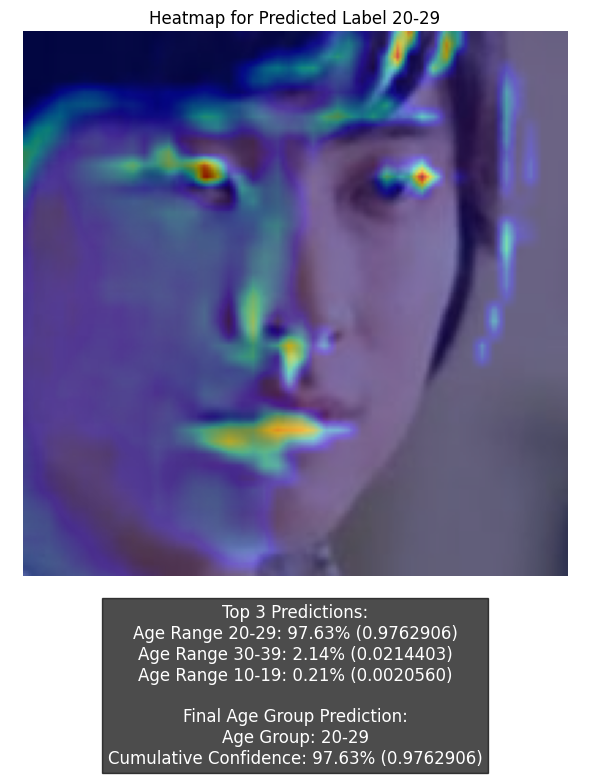

Top 3 Predictions:
Age Range 50-59: 28.01% (0.2800884)
Age Range 30-39: 17.96% (0.1795672)
Age Range 60-69: 15.20% (0.1520066)

Final Age Group Prediction:
Age Group: 20-79
Cumulative Confidence: 94.84% (0.9484479)


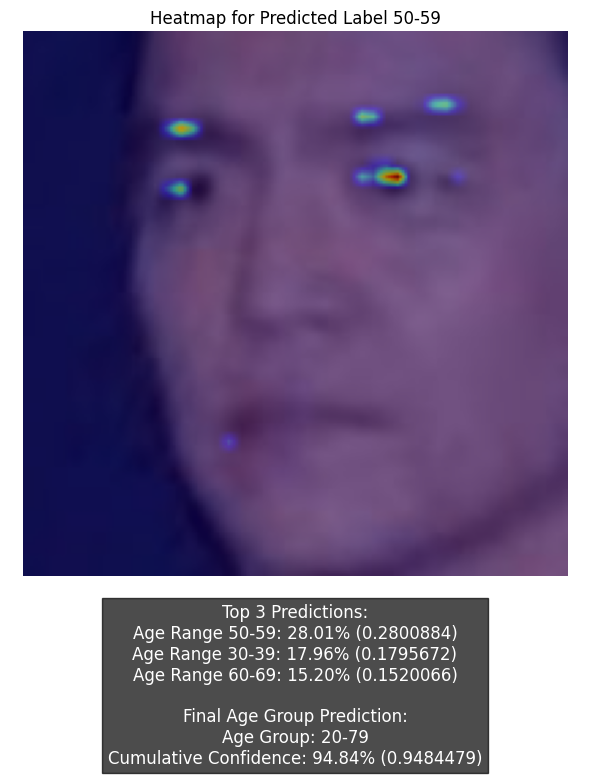

Top 3 Predictions:
Age Range 40-49: 41.17% (0.4116500)
Age Range 50-59: 32.33% (0.3232611)
Age Range 30-39: 19.76% (0.1976384)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 93.25% (0.9325495)


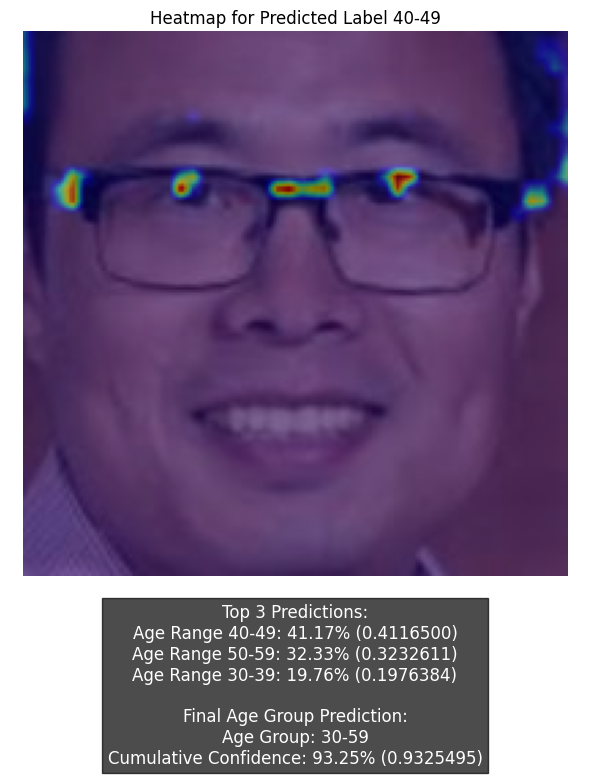

Top 3 Predictions:
Age Range 50-59: 16.30% (0.1630305)
Age Range 70-79: 14.95% (0.1494938)
Age Range 60-69: 14.89% (0.1489008)

Final Age Group Prediction:
Age Group: 0-89
Cumulative Confidence: 95.14% (0.9514132)


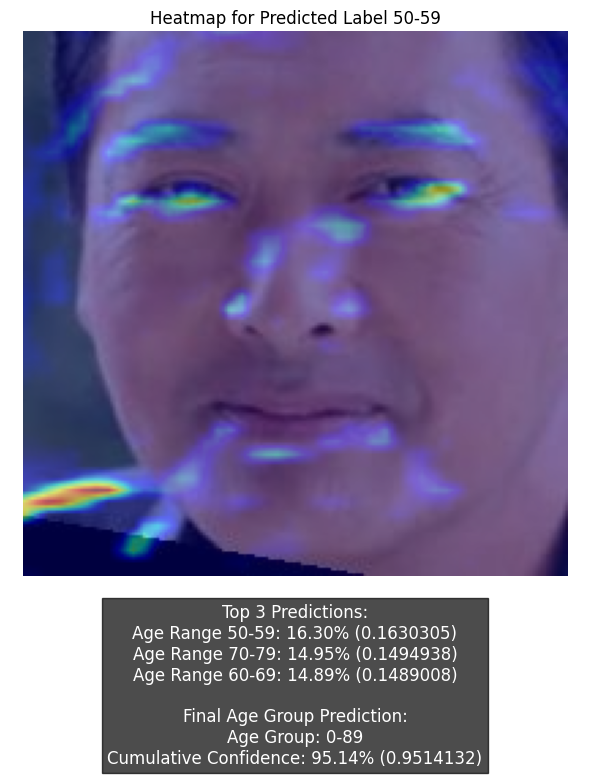

Top 3 Predictions:
Age Range 20-29: 99.38% (0.9938210)
Age Range 30-39: 0.58% (0.0058290)
Age Range 10-19: 0.03% (0.0003182)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 99.38% (0.9938210)


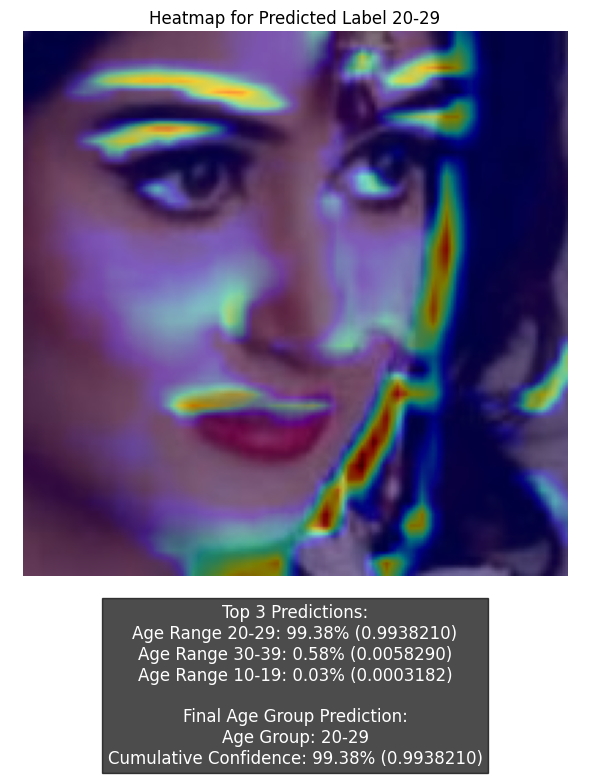

Top 3 Predictions:
Age Range 50-59: 40.24% (0.4023744)
Age Range 40-49: 18.30% (0.1829727)
Age Range 60-69: 17.96% (0.1795696)

Final Age Group Prediction:
Age Group: 30-79
Cumulative Confidence: 92.88% (0.9288296)


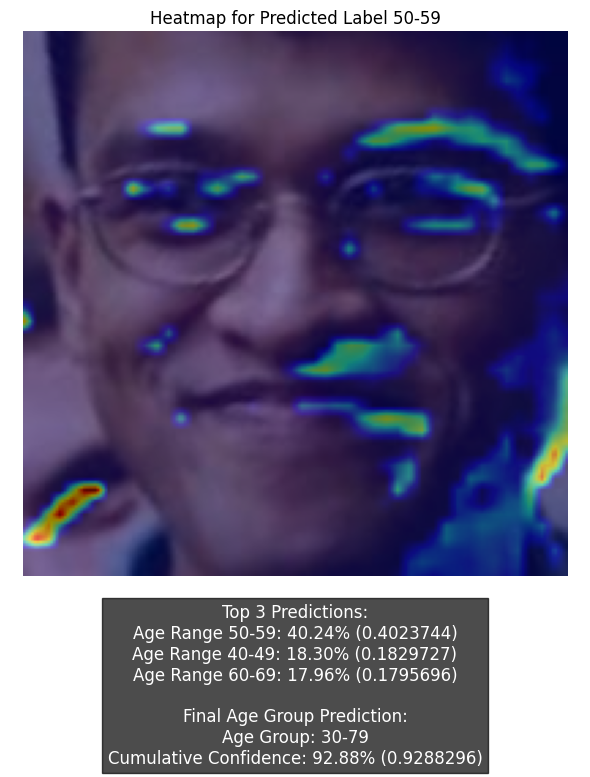

Top 3 Predictions:
Age Range 40-49: 55.49% (0.5549141)
Age Range 50-59: 21.92% (0.2191858)
Age Range 30-39: 20.76% (0.2075914)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 98.17% (0.9816913)


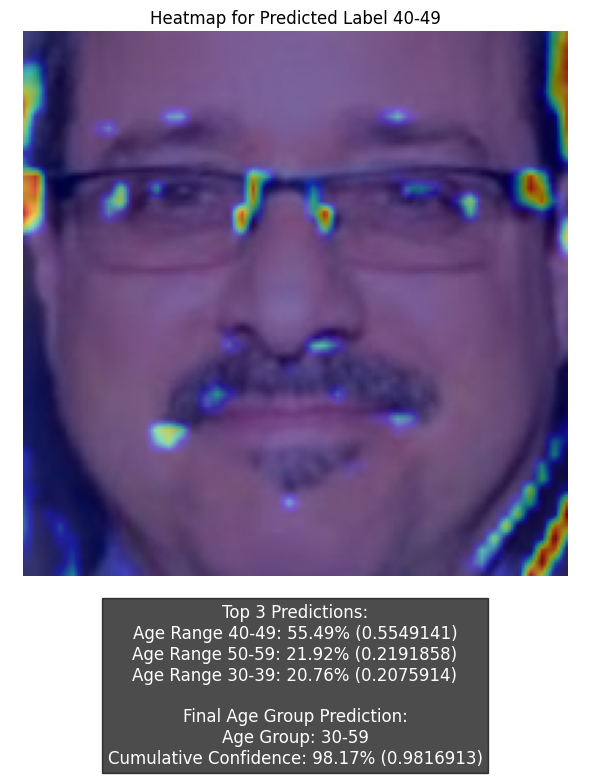

Top 3 Predictions:
Age Range 50-59: 42.54% (0.4253563)
Age Range 40-49: 38.26% (0.3826408)
Age Range 30-39: 13.09% (0.1308638)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 93.89% (0.9388610)


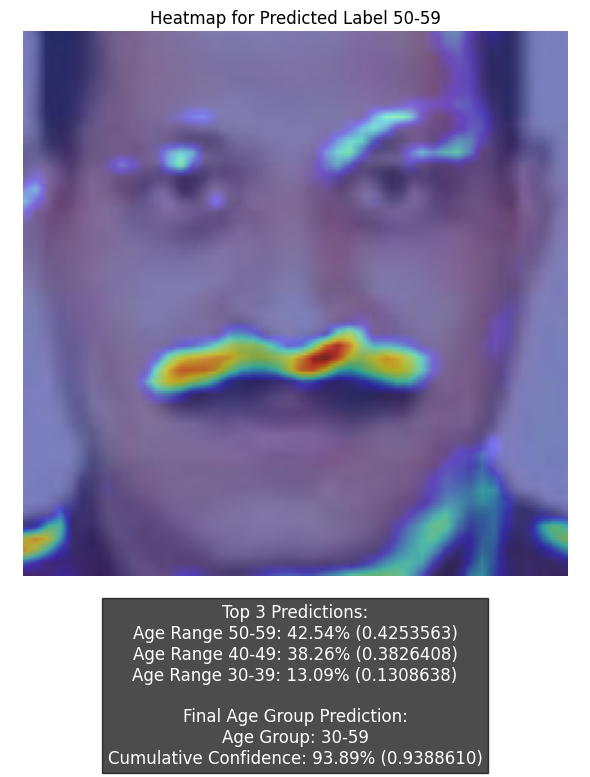

Top 3 Predictions:
Age Range 20-29: 94.09% (0.9408589)
Age Range 30-39: 4.48% (0.0448085)
Age Range 10-19: 1.31% (0.0130655)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 94.09% (0.9408589)


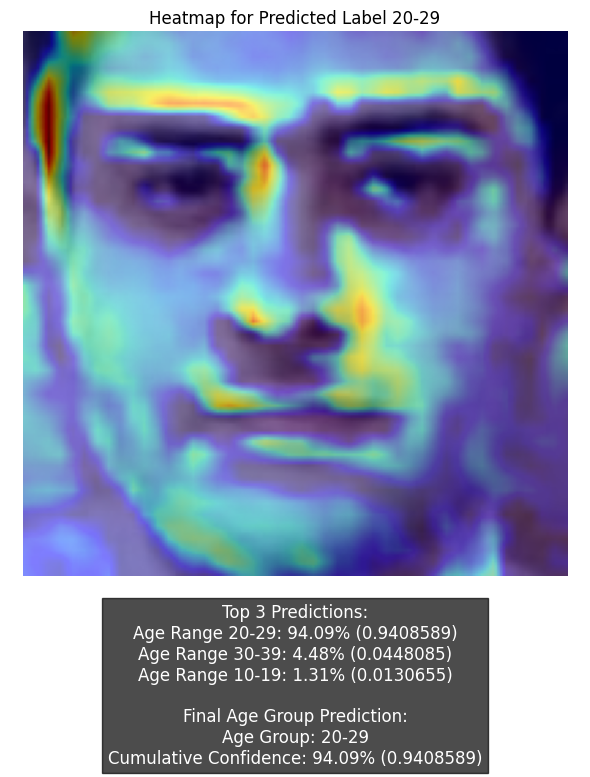

Top 3 Predictions:
Age Range 30-39: 65.18% (0.6517762)
Age Range 40-49: 21.20% (0.2119688)
Age Range 20-29: 11.66% (0.1165816)

Final Age Group Prediction:
Age Group: 20-49
Cumulative Confidence: 98.03% (0.9803266)


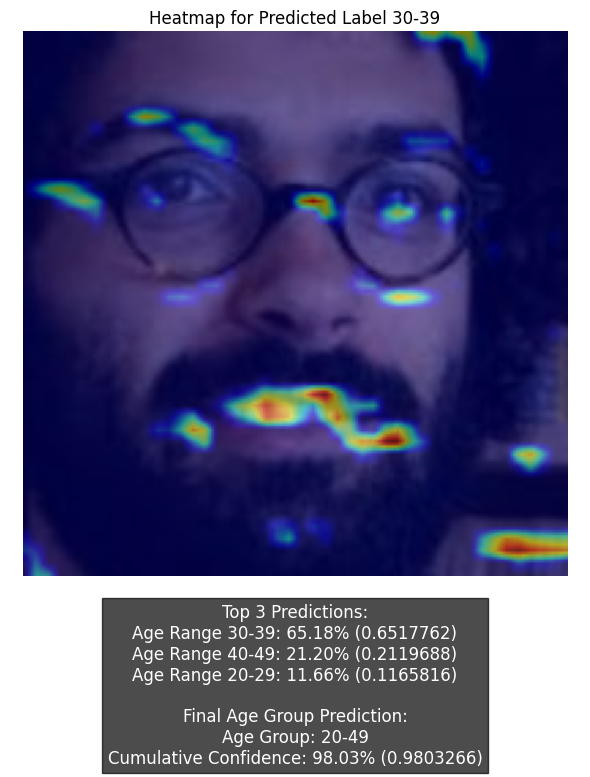

Top 3 Predictions:
Age Range 40-49: 55.33% (0.5533218)
Age Range 50-59: 21.75% (0.2174988)
Age Range 30-39: 21.03% (0.2103355)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 98.12% (0.9811561)


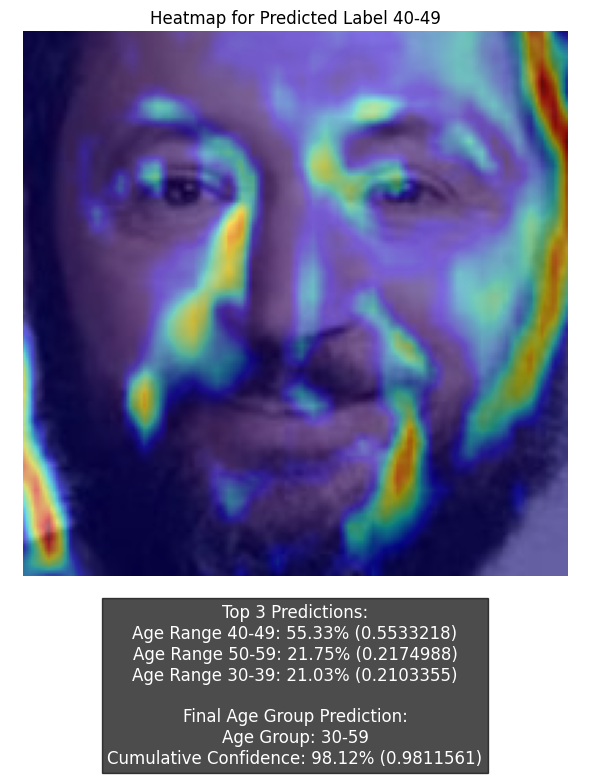

Top 3 Predictions:
Age Range 50-59: 44.69% (0.4468674)
Age Range 40-49: 31.99% (0.3198826)
Age Range 60-69: 9.78% (0.0977690)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 96.19% (0.9619009)


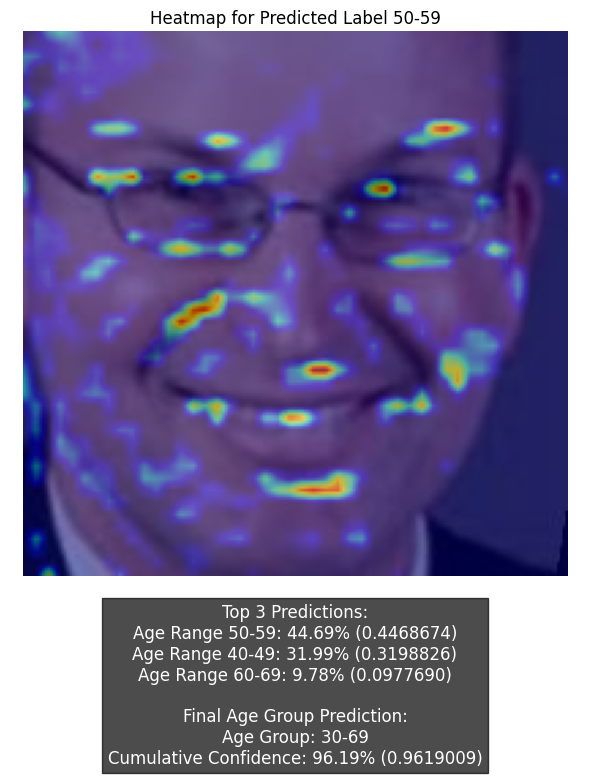

Top 3 Predictions:
Age Range 20-29: 98.18% (0.9817525)
Age Range 30-39: 1.46% (0.0146088)
Age Range 10-19: 0.32% (0.0032303)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 98.18% (0.9817525)


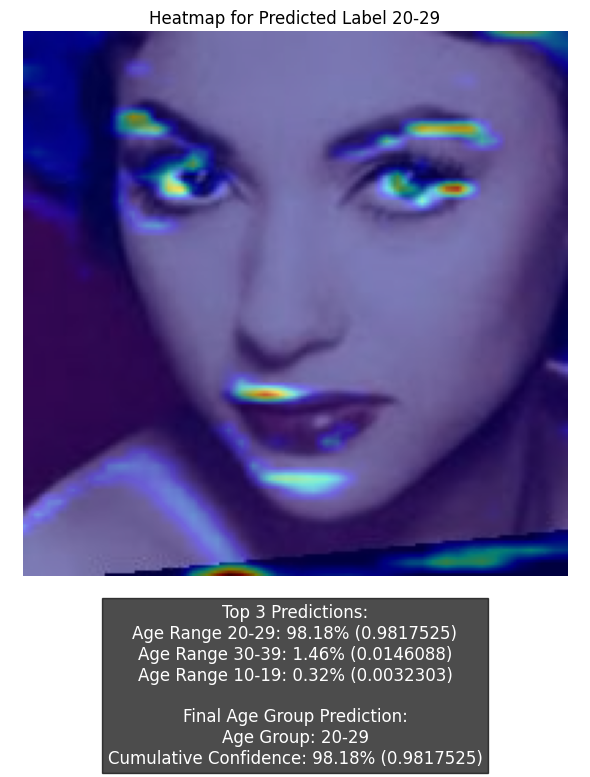

Top 3 Predictions:
Age Range 60-69: 34.56% (0.3456427)
Age Range 50-59: 33.25% (0.3325167)
Age Range 70-79: 17.60% (0.1760327)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 92.18% (0.9217801)


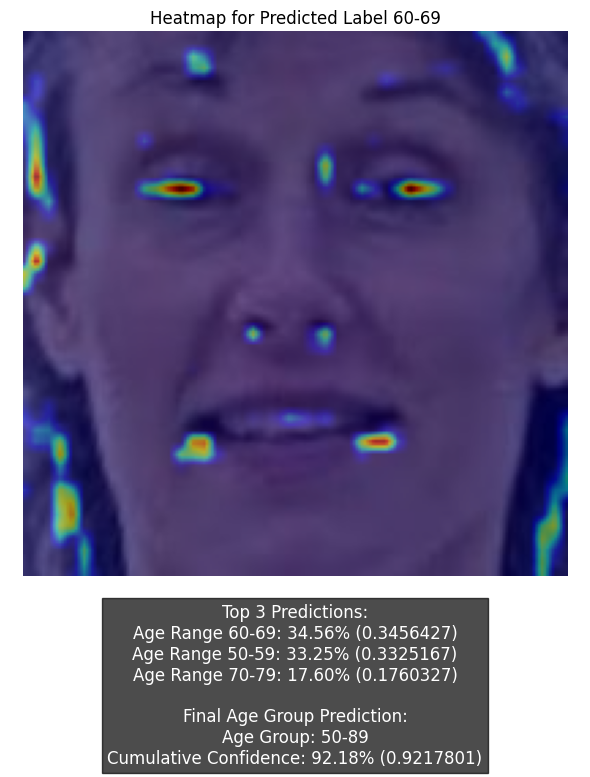

Top 3 Predictions:
Age Range 40-49: 49.58% (0.4957998)
Age Range 30-39: 37.59% (0.3758735)
Age Range 50-59: 9.11% (0.0911065)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 96.28% (0.9627798)


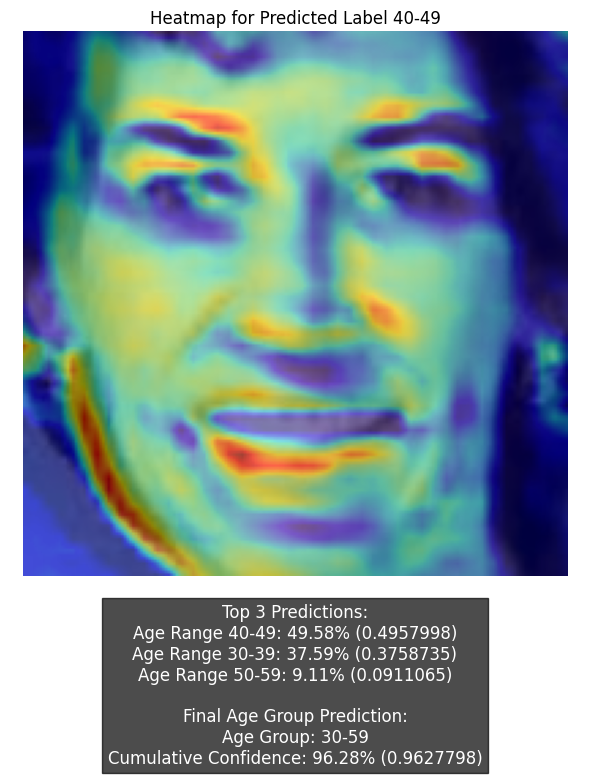

Top 3 Predictions:
Age Range 60-69: 32.12% (0.3212177)
Age Range 70-79: 27.17% (0.2717118)
Age Range 80-89: 17.66% (0.1766416)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 93.35% (0.9334702)


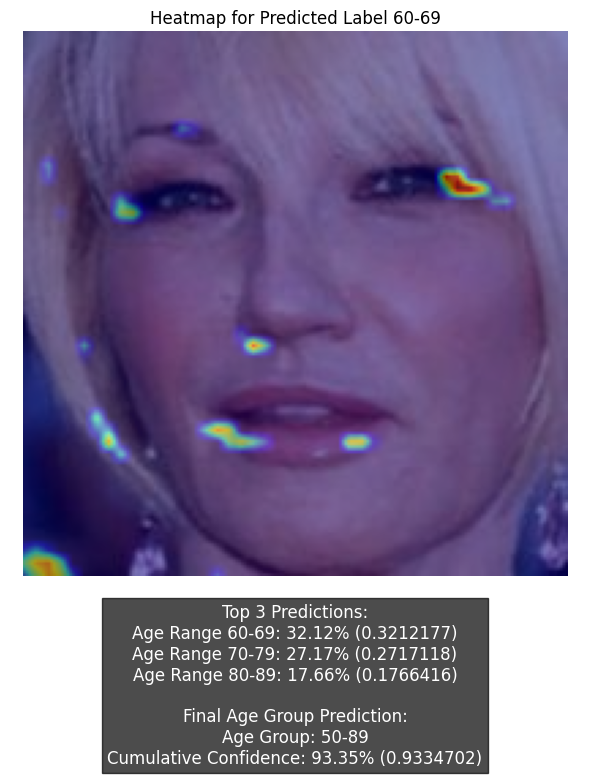

Top 3 Predictions:
Age Range 20-29: 95.49% (0.9548954)
Age Range 30-39: 4.29% (0.0429217)
Age Range 10-19: 0.18% (0.0017954)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 95.49% (0.9548954)


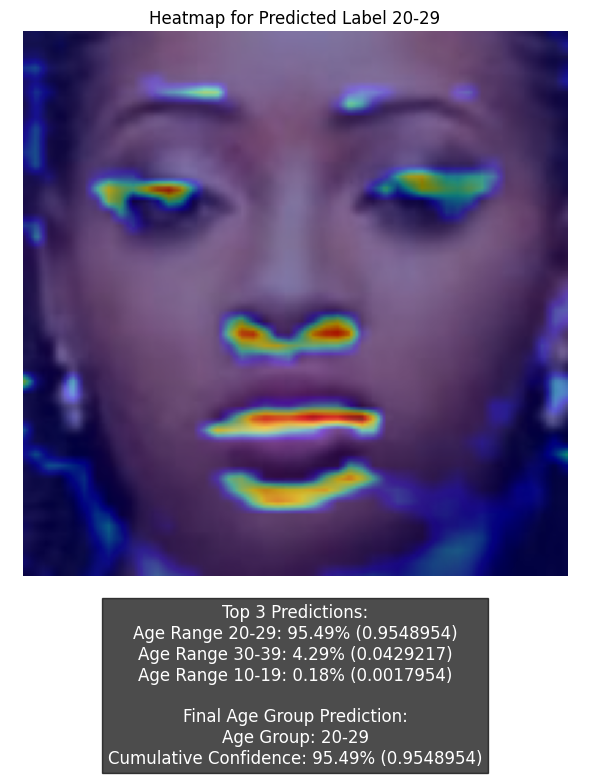

Top 3 Predictions:
Age Range 50-59: 22.78% (0.2278037)
Age Range 20-29: 18.88% (0.1887822)
Age Range 30-39: 18.54% (0.1853957)

Final Age Group Prediction:
Age Group: 20-79
Cumulative Confidence: 93.16% (0.9316235)


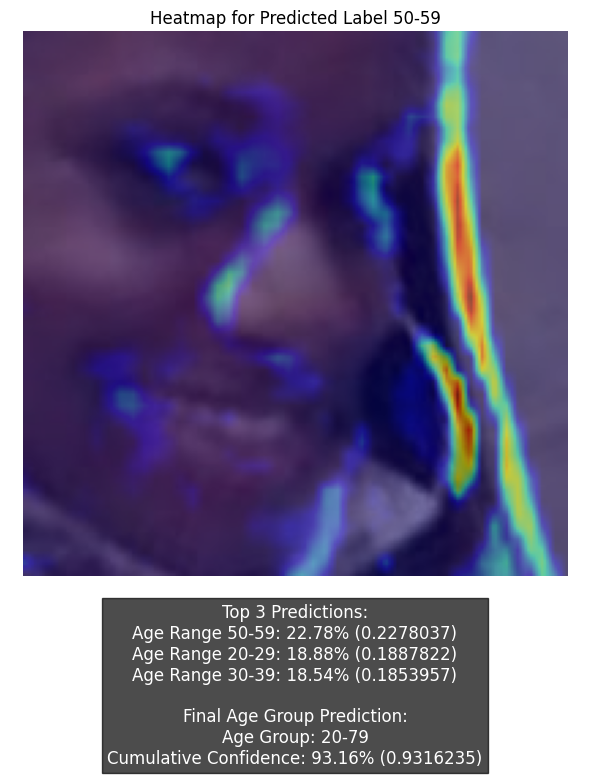

Top 3 Predictions:
Age Range 40-49: 39.99% (0.3998877)
Age Range 50-59: 30.46% (0.3045969)
Age Range 30-39: 20.07% (0.2007470)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 90.52% (0.9052316)


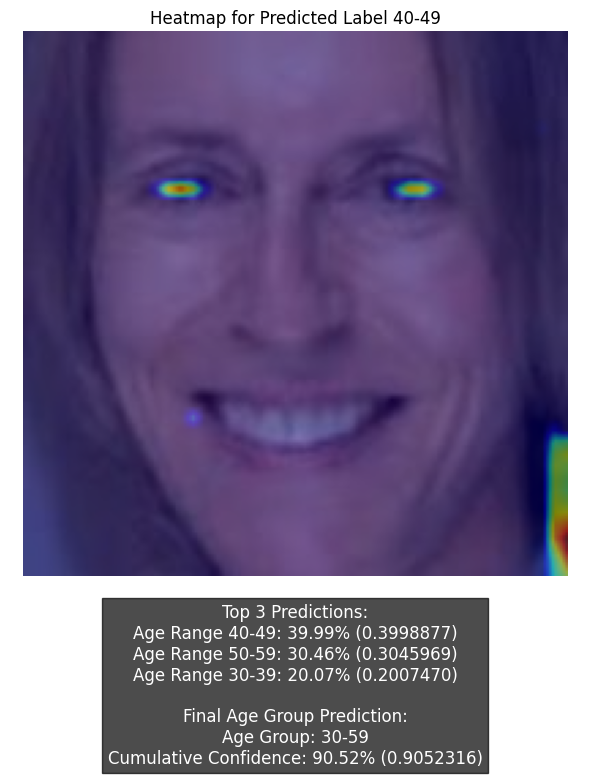

Top 3 Predictions:
Age Range 50-59: 37.02% (0.3701879)
Age Range 40-49: 34.97% (0.3496758)
Age Range 30-39: 21.00% (0.2100344)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 92.99% (0.9298981)


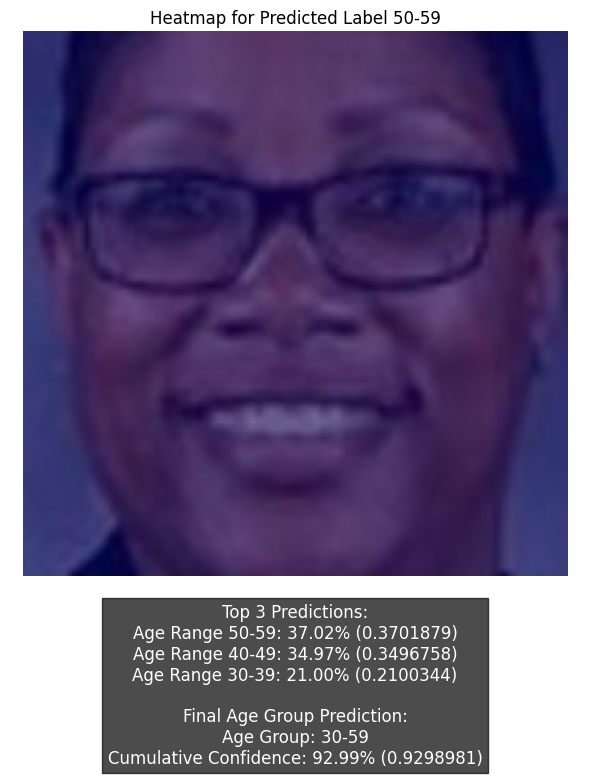

Top 3 Predictions:
Age Range 20-29: 98.62% (0.9862244)
Age Range 30-39: 1.04% (0.0103874)
Age Range 10-19: 0.32% (0.0032034)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 98.62% (0.9862244)


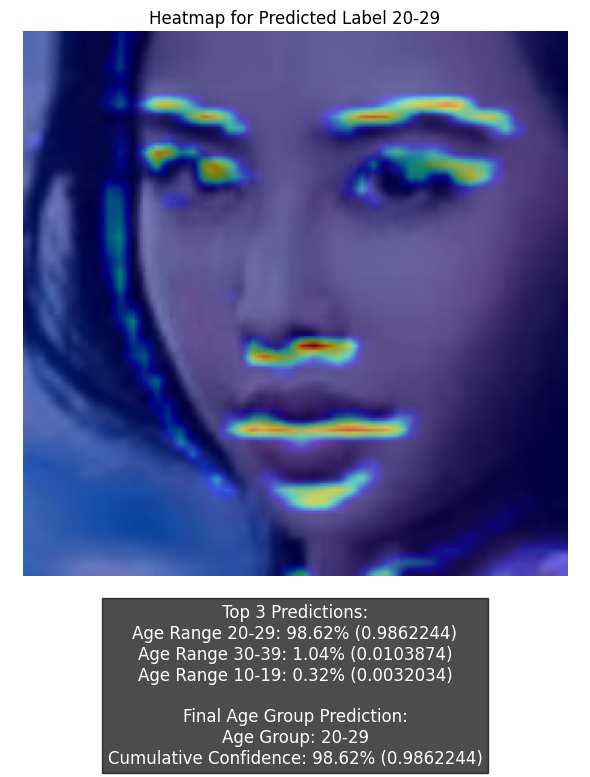

Top 3 Predictions:
Age Range 60-69: 16.31% (0.1630892)
Age Range 50-59: 15.48% (0.1547986)
Age Range 70-79: 14.40% (0.1440473)

Final Age Group Prediction:
Age Group: 10-89
Cumulative Confidence: 93.37% (0.9337306)


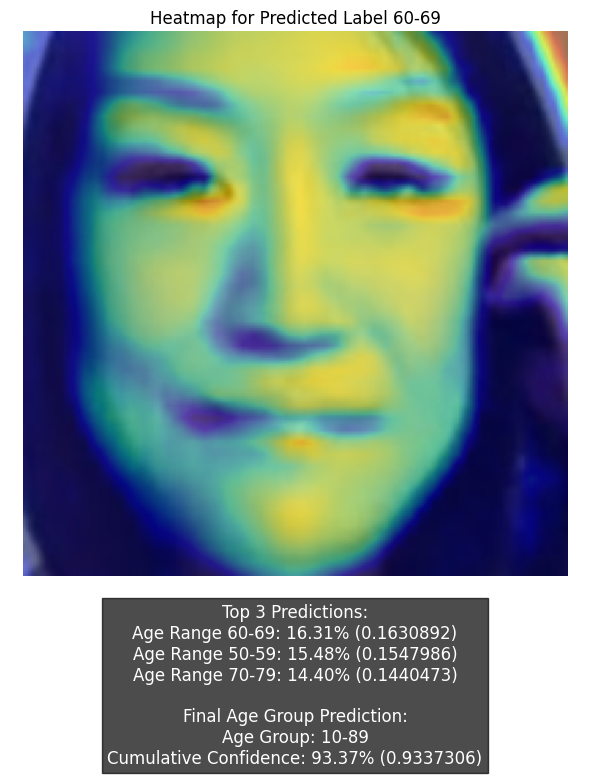

Top 3 Predictions:
Age Range 20-29: 18.06% (0.1806473)
Age Range 30-39: 16.40% (0.1639667)
Age Range 40-49: 14.04% (0.1404123)

Final Age Group Prediction:
Age Group: 0-69
Cumulative Confidence: 90.75% (0.9074871)


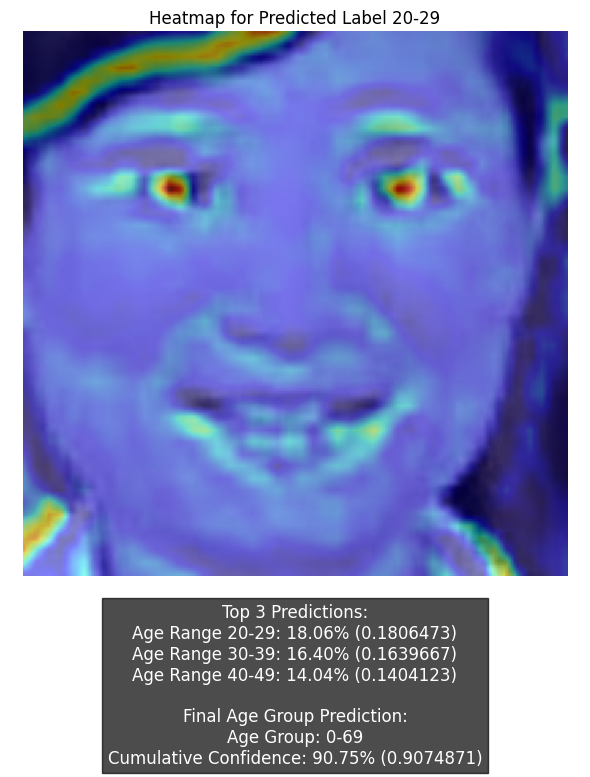

Top 3 Predictions:
Age Range 50-59: 29.58% (0.2957996)
Age Range 60-69: 22.10% (0.2209803)
Age Range 40-49: 15.76% (0.1576366)

Final Age Group Prediction:
Age Group: 30-89
Cumulative Confidence: 95.36% (0.9536448)


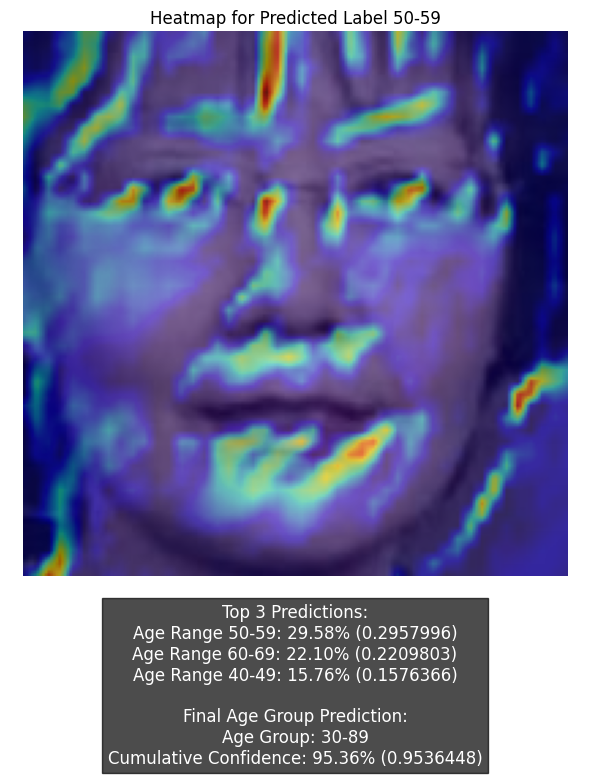

Top 3 Predictions:
Age Range 20-29: 97.82% (0.9781612)
Age Range 30-39: 2.12% (0.0212244)
Age Range 10-19: 0.05% (0.0004661)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 97.82% (0.9781612)


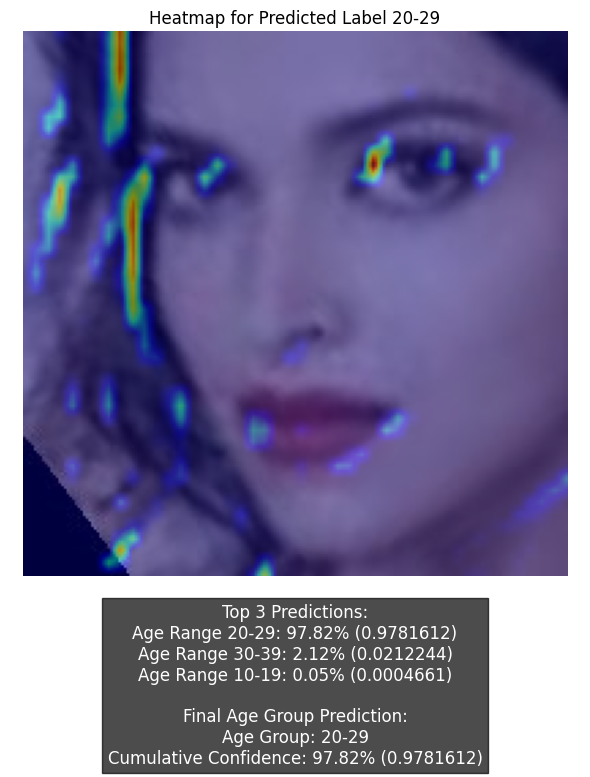

Top 3 Predictions:
Age Range 40-49: 33.38% (0.3338129)
Age Range 50-59: 27.66% (0.2765782)
Age Range 30-39: 25.66% (0.2565723)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 92.58% (0.9257584)


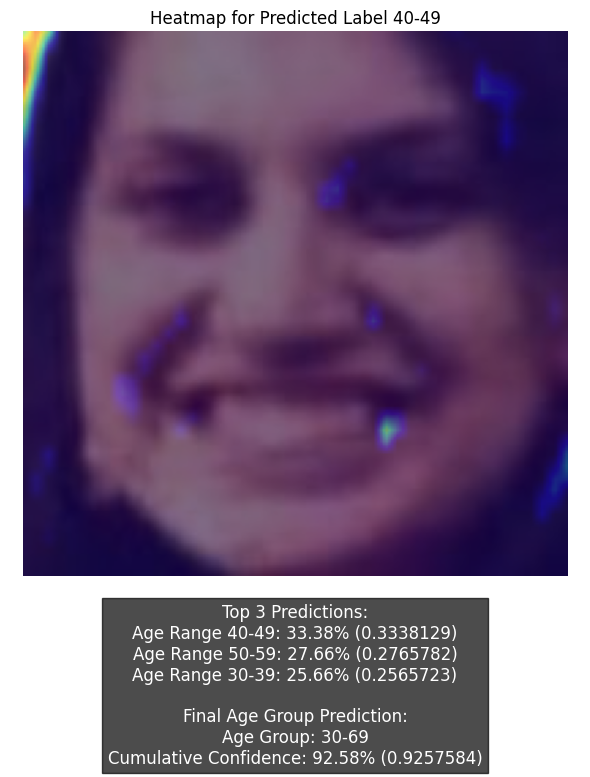

Top 3 Predictions:
Age Range 10-19: 72.79% (0.7278857)
Age Range 0-9: 16.92% (0.1691663)
Age Range 20-29: 6.56% (0.0655534)

Final Age Group Prediction:
Age Group: 0-29
Cumulative Confidence: 96.26% (0.9626054)


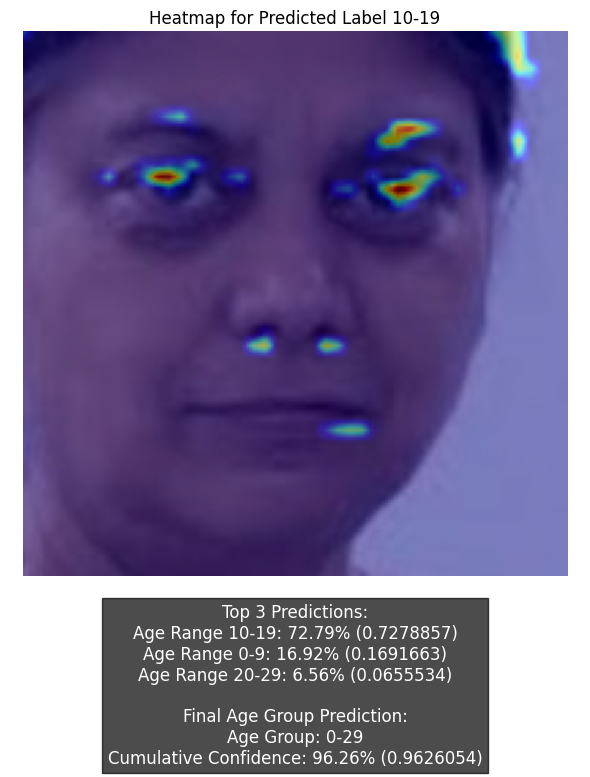

Top 3 Predictions:
Age Range 50-59: 31.64% (0.3164095)
Age Range 40-49: 28.80% (0.2879596)
Age Range 30-39: 20.34% (0.2034385)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 90.51% (0.9050552)


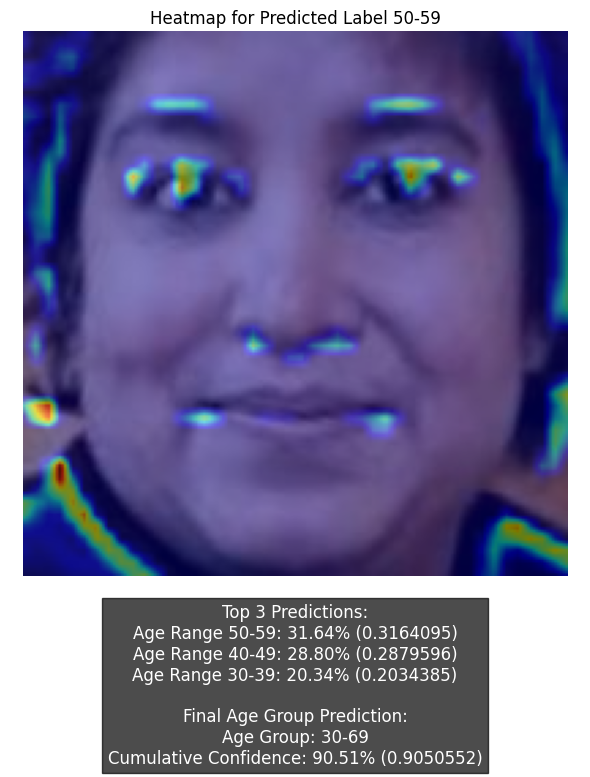

Top 3 Predictions:
Age Range 20-29: 95.88% (0.9587865)
Age Range 30-39: 4.01% (0.0400507)
Age Range 10-19: 0.09% (0.0009229)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 95.88% (0.9587865)


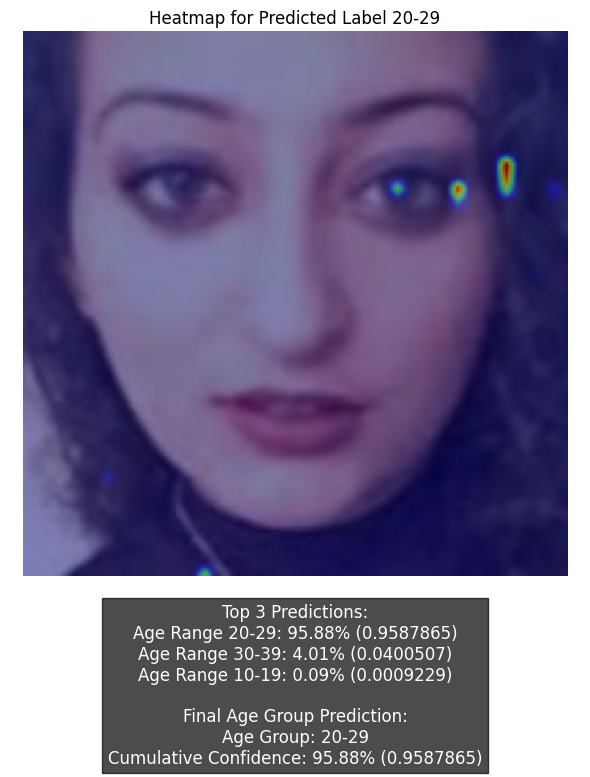

Top 3 Predictions:
Age Range 30-39: 33.89% (0.3389454)
Age Range 20-29: 20.11% (0.2011474)
Age Range 40-49: 19.79% (0.1979133)

Final Age Group Prediction:
Age Group: 20-69
Cumulative Confidence: 92.15% (0.9214905)


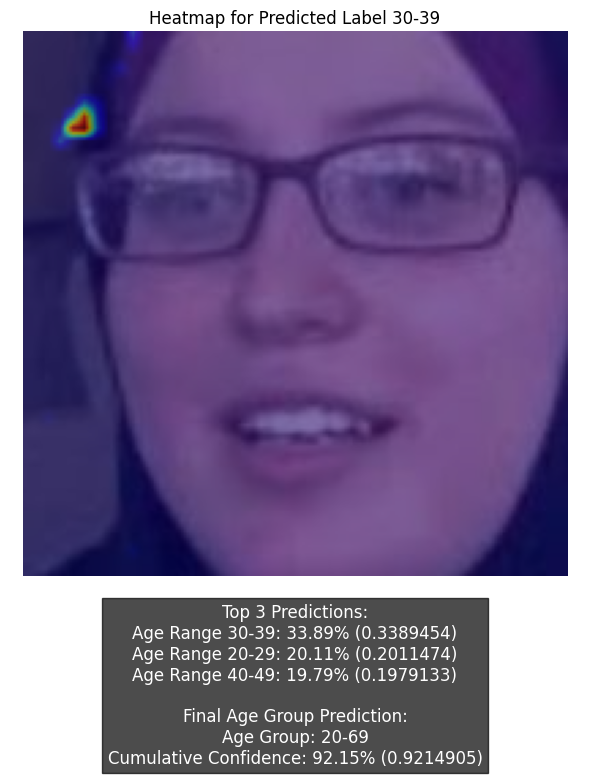

Top 3 Predictions:
Age Range 20-29: 61.32% (0.6132448)
Age Range 30-39: 31.01% (0.3101452)
Age Range 40-49: 3.80% (0.0380433)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 92.34% (0.9233899)


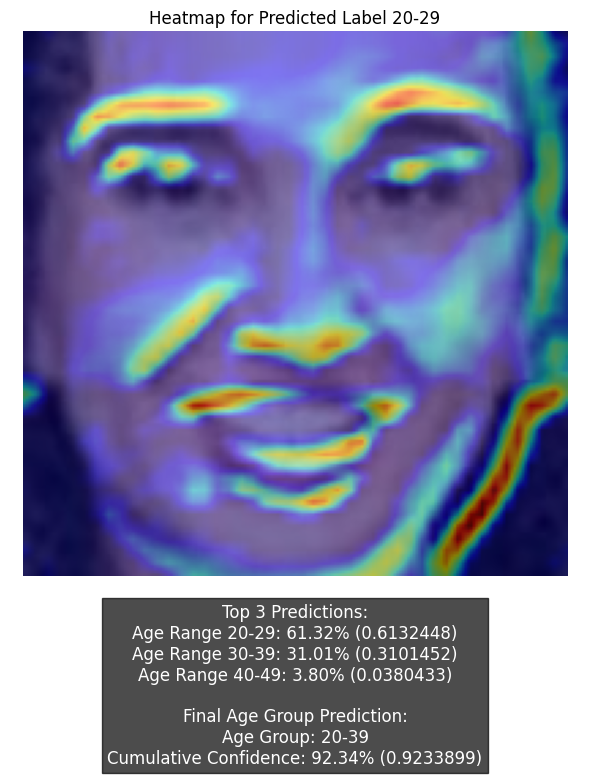

Top 3 Predictions:
Age Range 30-39: 35.52% (0.3551840)
Age Range 20-29: 29.89% (0.2989269)
Age Range 40-49: 14.69% (0.1469419)

Final Age Group Prediction:
Age Group: 10-59
Cumulative Confidence: 93.55% (0.9354835)


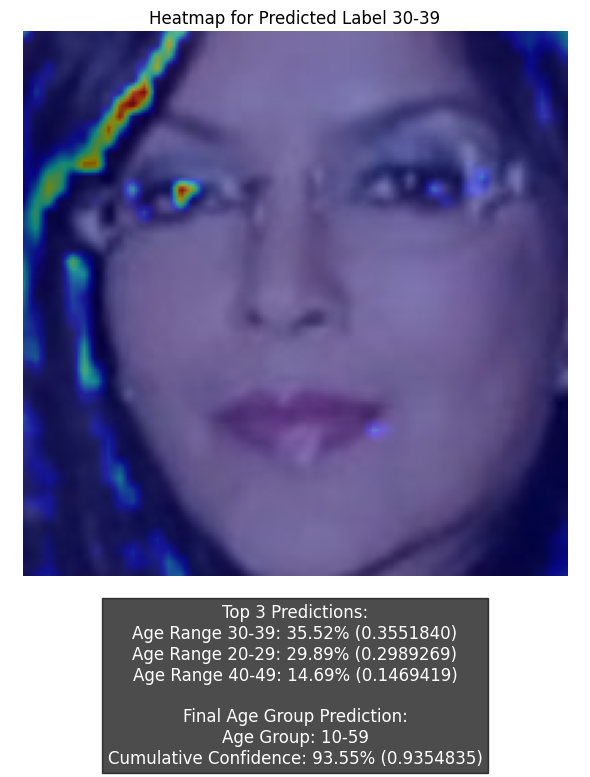

In [92]:
df_to_process = pd.read_csv('base_model_prototypes_and_criticisms.csv')

for index, row in df_to_process.iterrows():
    prototype_image_path = row['Prototype_Image_Path']
    criticism_image_path = row['Criticism_Image_Path']
    
    prototype_save_file = f"images/prototypes_and_criticisms/base_heatmap_prototype_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    criticism_save_file = f"images/prototypes_and_criticisms/base_heatmap_criticism_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    
    predict_xai(base_model, prototype_image_path, plot_heatmap=True, save_file=prototype_save_file)
    predict_xai(base_model, criticism_image_path, plot_heatmap=True, save_file=criticism_save_file)

Top 3 Predictions:
Age Range 20-29: 78.40% (0.7840425)
Age Range 30-39: 10.73% (0.1072779)
Age Range 10-19: 9.67% (0.0966856)

Final Age Group Prediction:
Age Group: 10-39
Cumulative Confidence: 98.80% (0.9880061)


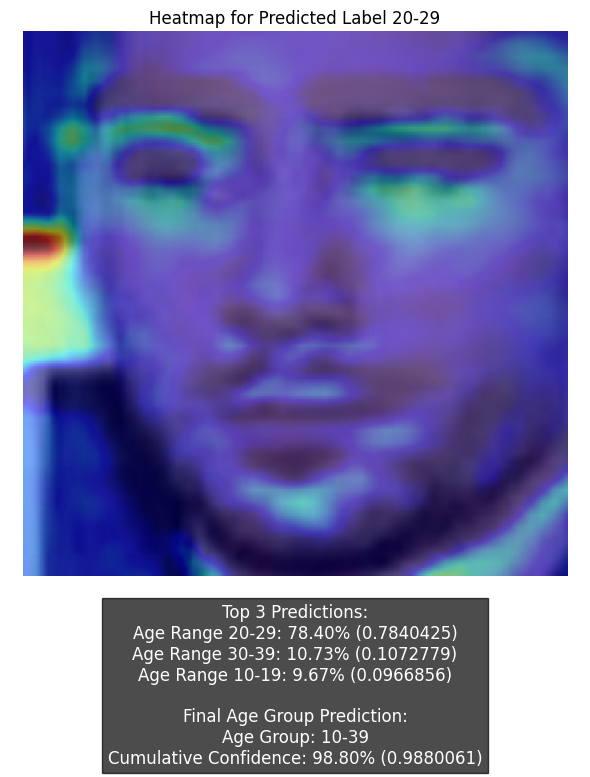

Top 3 Predictions:
Age Range 30-39: 34.38% (0.3437588)
Age Range 20-29: 21.42% (0.2141777)
Age Range 50-59: 20.22% (0.2021779)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 90.62% (0.9061738)


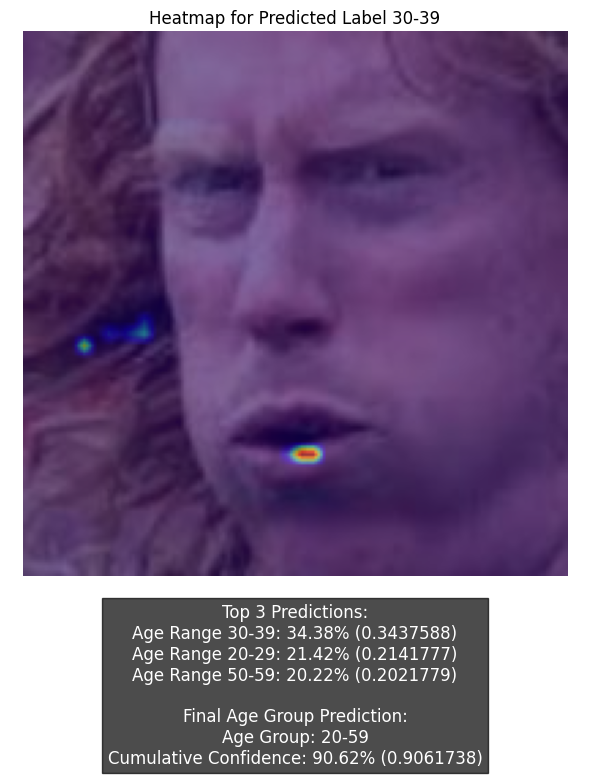

Top 3 Predictions:
Age Range 40-49: 51.54% (0.5153514)
Age Range 30-39: 34.70% (0.3469558)
Age Range 50-59: 10.90% (0.1089586)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 97.13% (0.9712658)


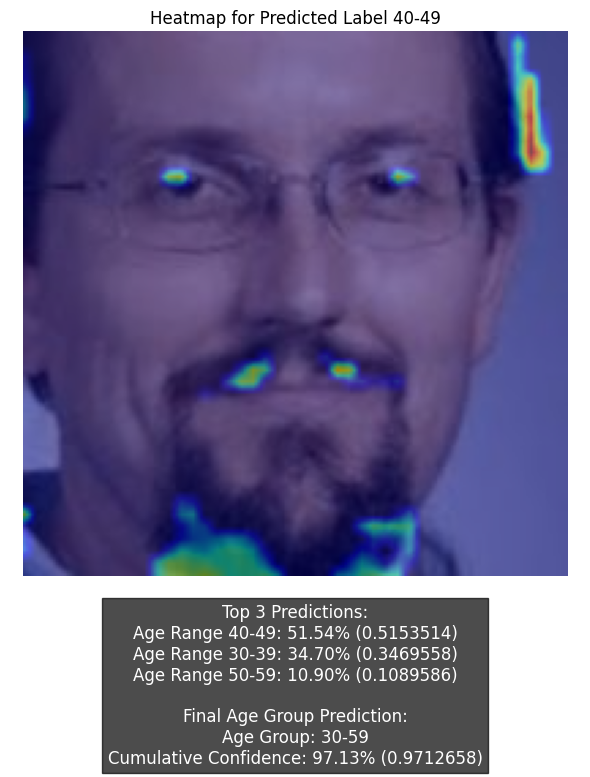

Top 3 Predictions:
Age Range 70-79: 25.23% (0.2523279)
Age Range 60-69: 22.73% (0.2272797)
Age Range 50-59: 19.66% (0.1966059)

Final Age Group Prediction:
Age Group: 40-89
Cumulative Confidence: 91.46% (0.9145580)


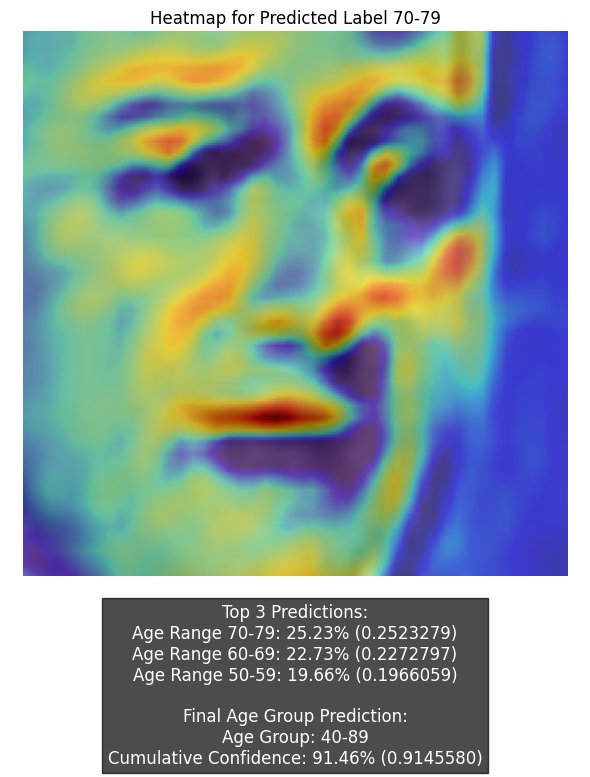

Top 3 Predictions:
Age Range 20-29: 73.86% (0.7386386)
Age Range 30-39: 24.95% (0.2495234)
Age Range 40-49: 0.74% (0.0073669)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 98.82% (0.9881620)


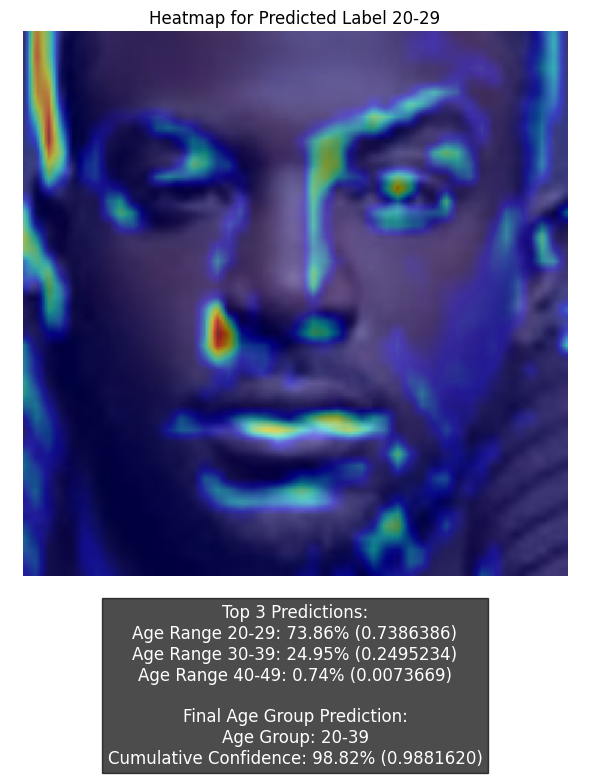

Top 3 Predictions:
Age Range 50-59: 24.77% (0.2477434)
Age Range 30-39: 23.22% (0.2321587)
Age Range 20-29: 15.79% (0.1579027)

Final Age Group Prediction:
Age Group: 20-79
Cumulative Confidence: 94.14% (0.9414189)


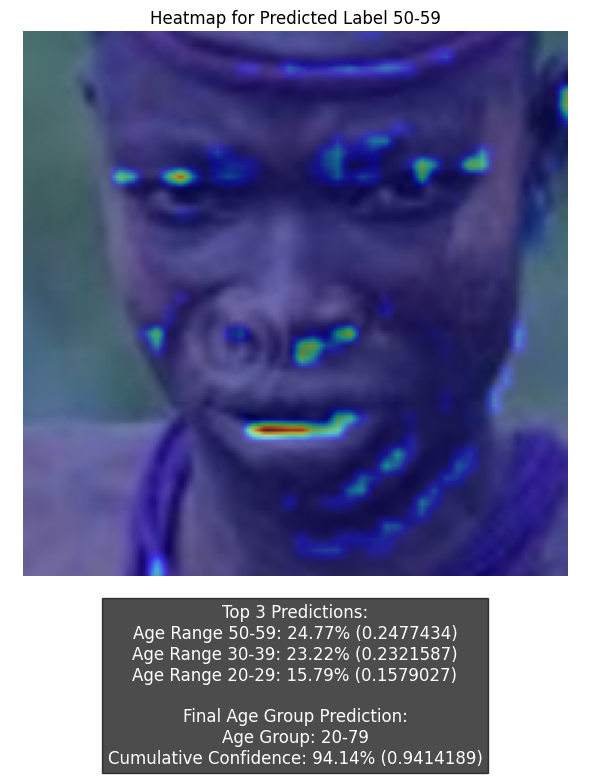

Top 3 Predictions:
Age Range 30-39: 47.16% (0.4716487)
Age Range 40-49: 32.42% (0.3242252)
Age Range 50-59: 13.07% (0.1307286)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 92.66% (0.9266026)


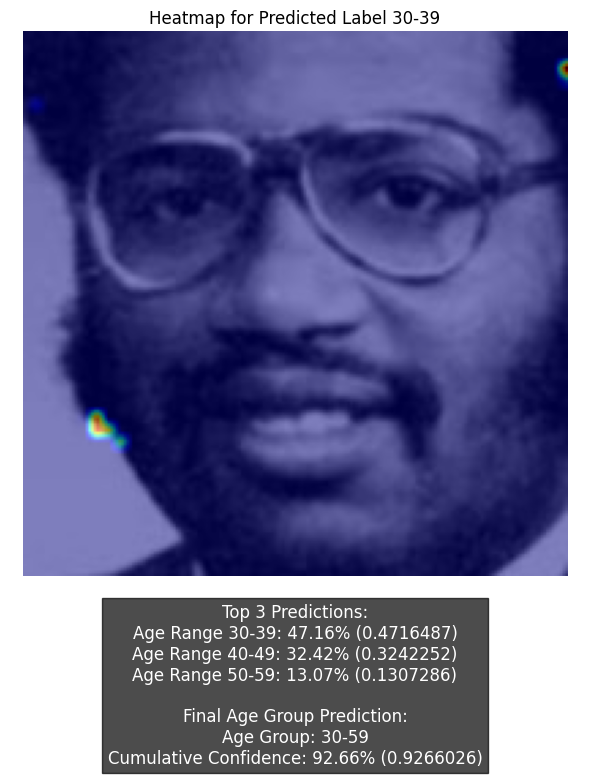

Top 3 Predictions:
Age Range 40-49: 41.01% (0.4101073)
Age Range 50-59: 27.94% (0.2794190)
Age Range 30-39: 27.81% (0.2781446)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 96.77% (0.9676709)


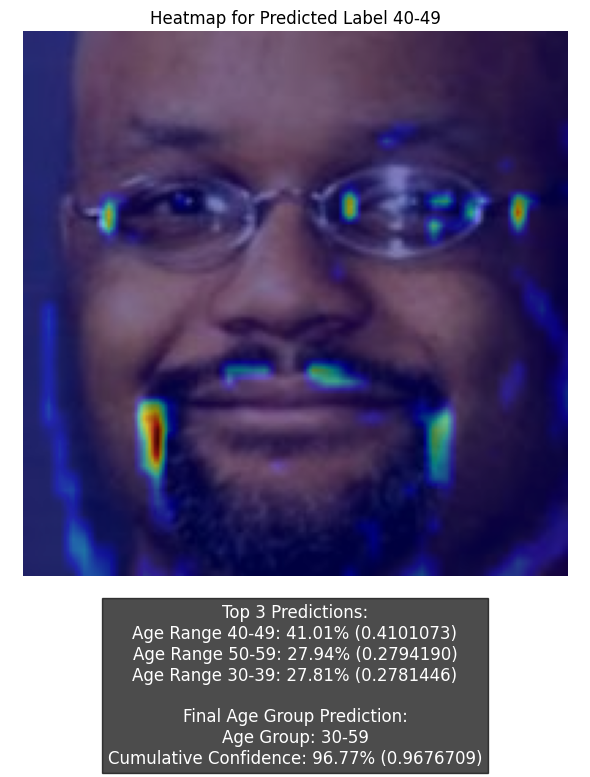

Top 3 Predictions:
Age Range 20-29: 90.06% (0.9005532)
Age Range 30-39: 9.48% (0.0948357)
Age Range 40-49: 0.21% (0.0021038)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 90.06% (0.9005532)


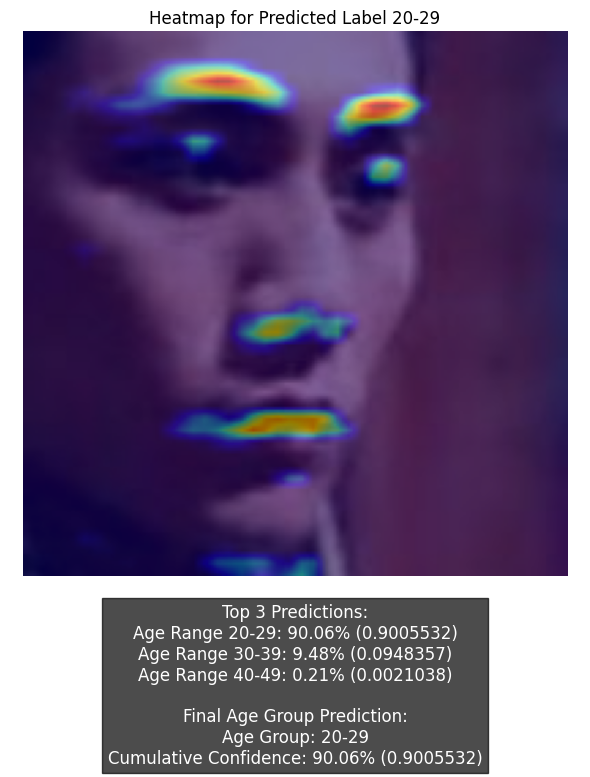

Top 3 Predictions:
Age Range 30-39: 35.85% (0.3584707)
Age Range 40-49: 32.30% (0.3229990)
Age Range 50-59: 16.53% (0.1652626)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 96.25% (0.9624856)


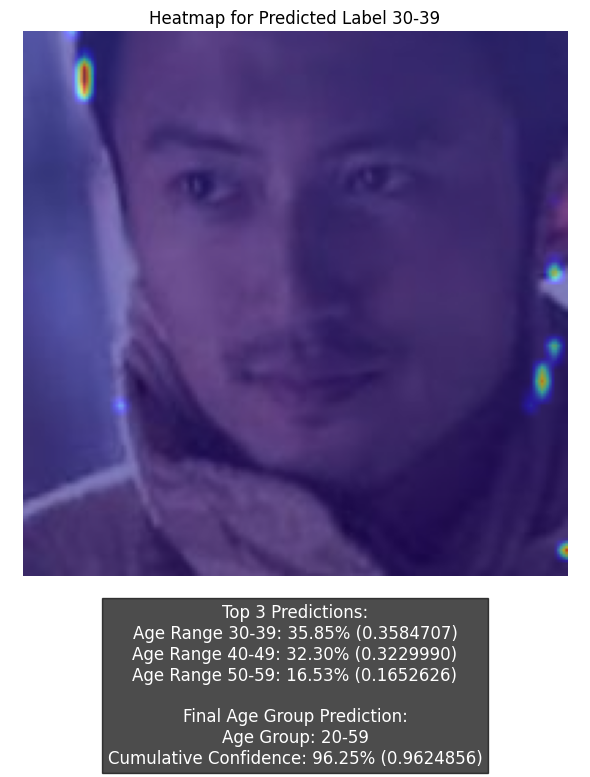

Top 3 Predictions:
Age Range 40-49: 41.17% (0.4116500)
Age Range 50-59: 32.33% (0.3232611)
Age Range 30-39: 19.76% (0.1976384)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 93.25% (0.9325495)


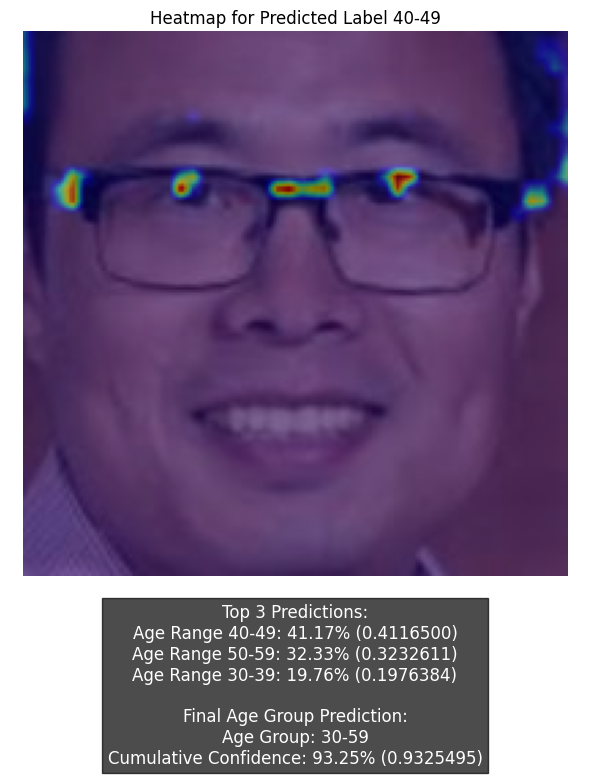

Top 3 Predictions:
Age Range 30-39: 41.30% (0.4129872)
Age Range 20-29: 22.28% (0.2227900)
Age Range 40-49: 20.66% (0.2065582)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 93.06% (0.9306436)


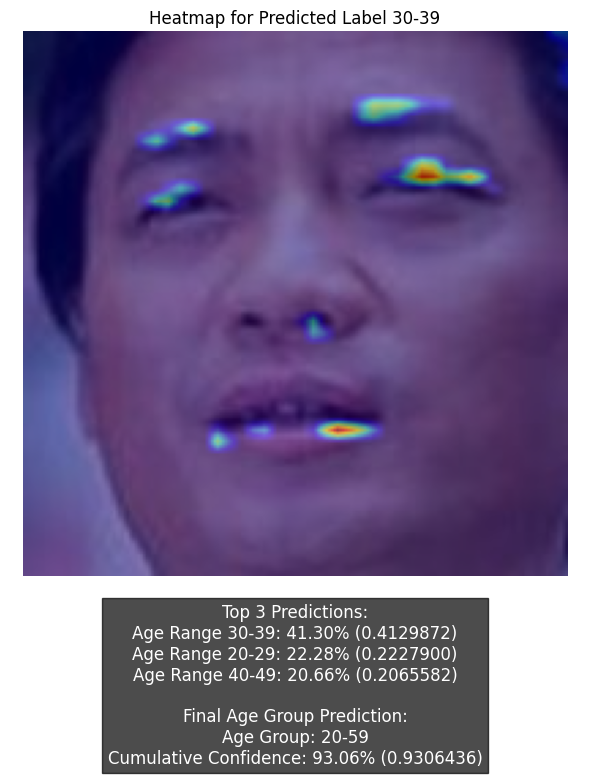

Top 3 Predictions:
Age Range 20-29: 99.38% (0.9938210)
Age Range 30-39: 0.58% (0.0058290)
Age Range 10-19: 0.03% (0.0003182)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 99.38% (0.9938210)


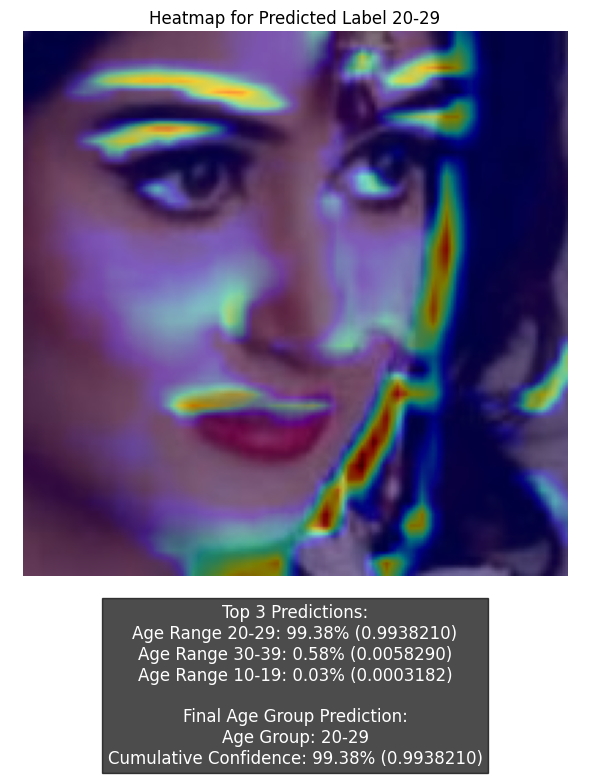

Top 3 Predictions:
Age Range 50-59: 40.24% (0.4023744)
Age Range 40-49: 18.30% (0.1829727)
Age Range 60-69: 17.96% (0.1795696)

Final Age Group Prediction:
Age Group: 30-79
Cumulative Confidence: 92.88% (0.9288296)


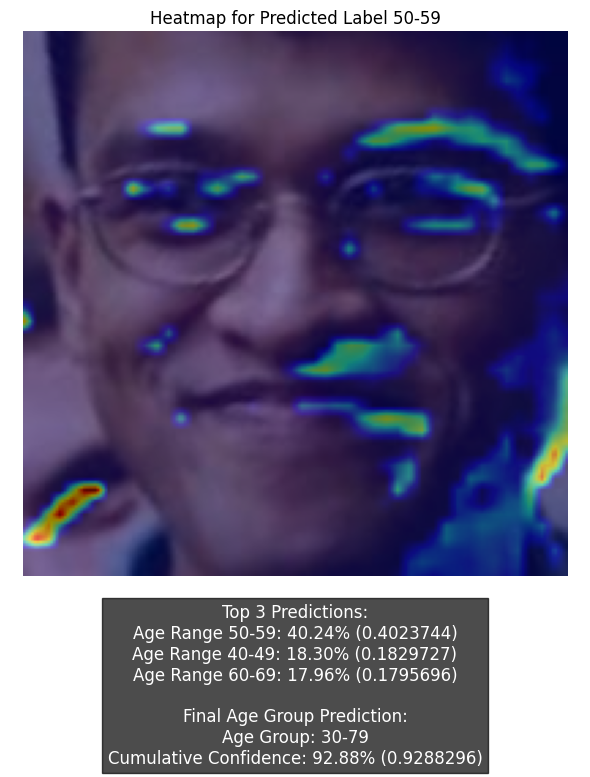

Top 3 Predictions:
Age Range 30-39: 31.28% (0.3128316)
Age Range 40-49: 24.16% (0.2415666)
Age Range 50-59: 18.29% (0.1829282)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 91.95% (0.9194714)


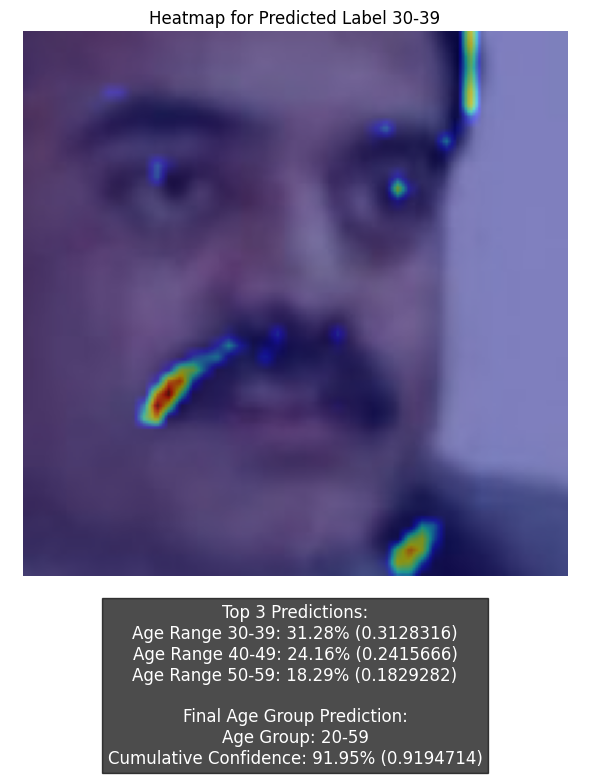

Top 3 Predictions:
Age Range 50-59: 47.40% (0.4739565)
Age Range 60-69: 20.72% (0.2072469)
Age Range 40-49: 14.67% (0.1467220)

Final Age Group Prediction:
Age Group: 30-79
Cumulative Confidence: 95.75% (0.9574559)


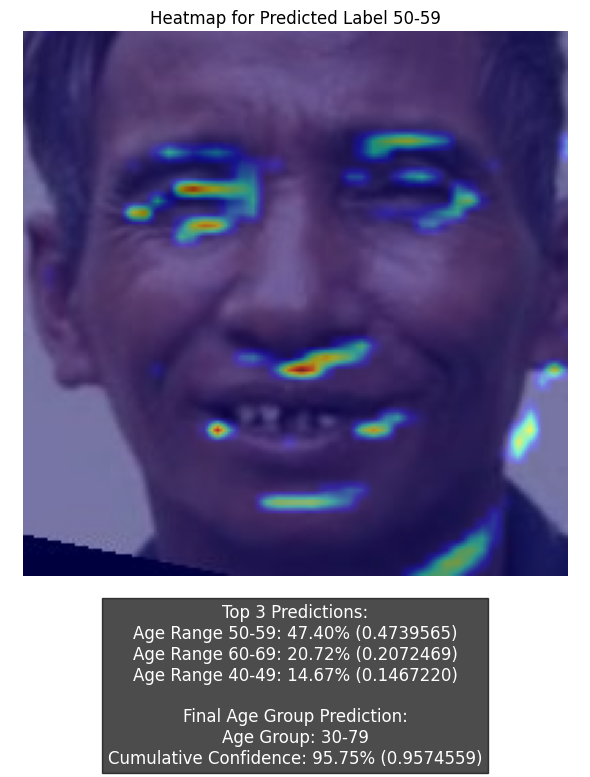

Top 3 Predictions:
Age Range 20-29: 74.17% (0.7416964)
Age Range 30-39: 22.44% (0.2243642)
Age Range 40-49: 1.62% (0.0162062)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 96.61% (0.9660605)


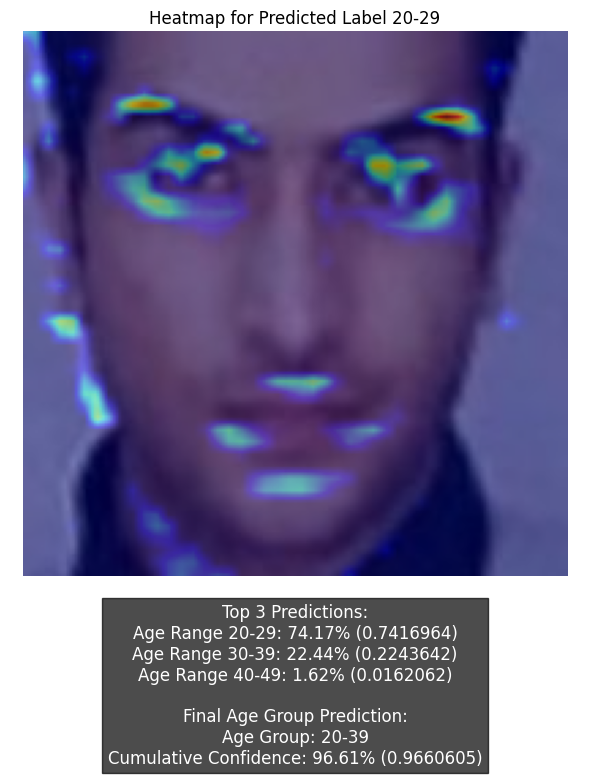

Top 3 Predictions:
Age Range 30-39: 38.05% (0.3805119)
Age Range 40-49: 25.12% (0.2512348)
Age Range 50-59: 16.40% (0.1640148)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 93.43% (0.9343411)


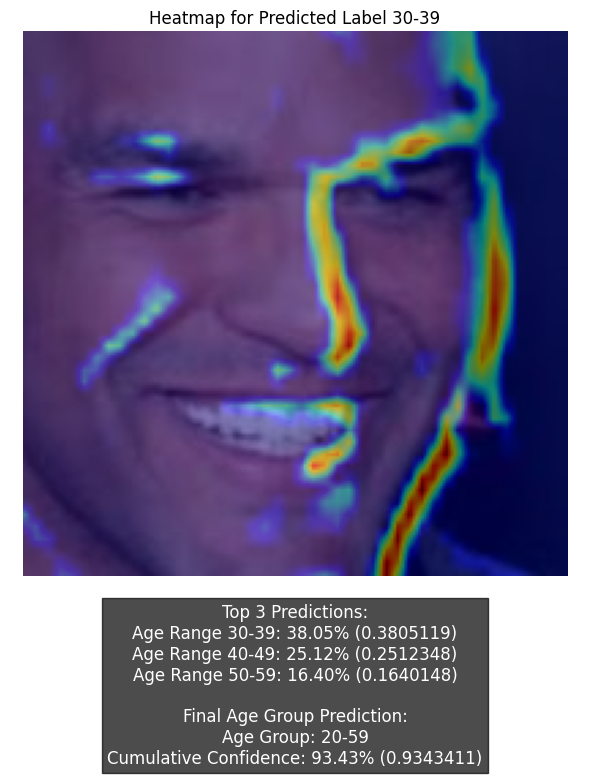

Top 3 Predictions:
Age Range 40-49: 55.33% (0.5533218)
Age Range 50-59: 21.75% (0.2174988)
Age Range 30-39: 21.03% (0.2103355)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 98.12% (0.9811561)


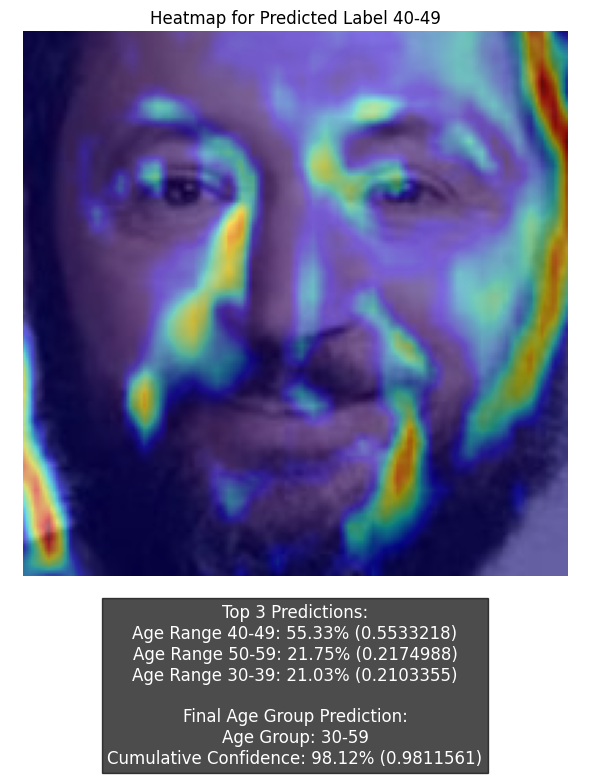

Top 3 Predictions:
Age Range 50-59: 44.69% (0.4468674)
Age Range 40-49: 31.99% (0.3198826)
Age Range 60-69: 9.78% (0.0977690)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 96.19% (0.9619009)


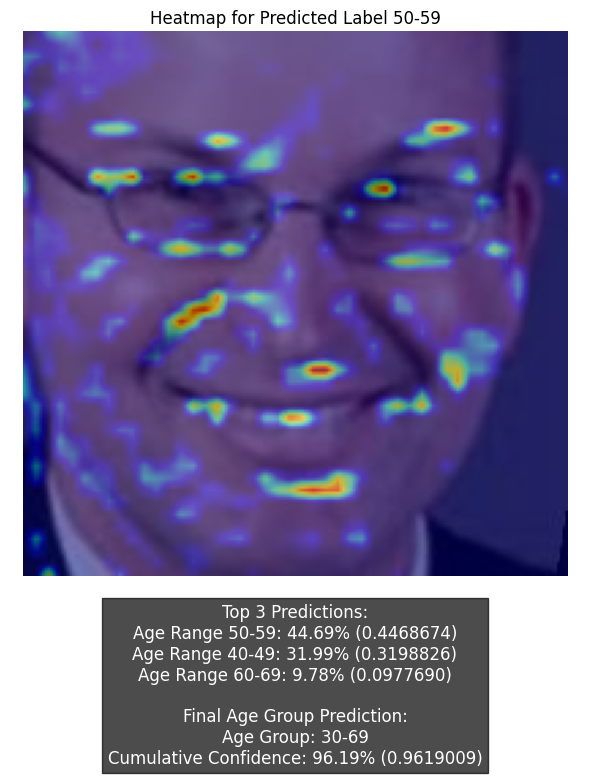

Top 3 Predictions:
Age Range 20-29: 98.05% (0.9804914)
Age Range 30-39: 1.49% (0.0148958)
Age Range 10-19: 0.39% (0.0038657)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 98.05% (0.9804914)


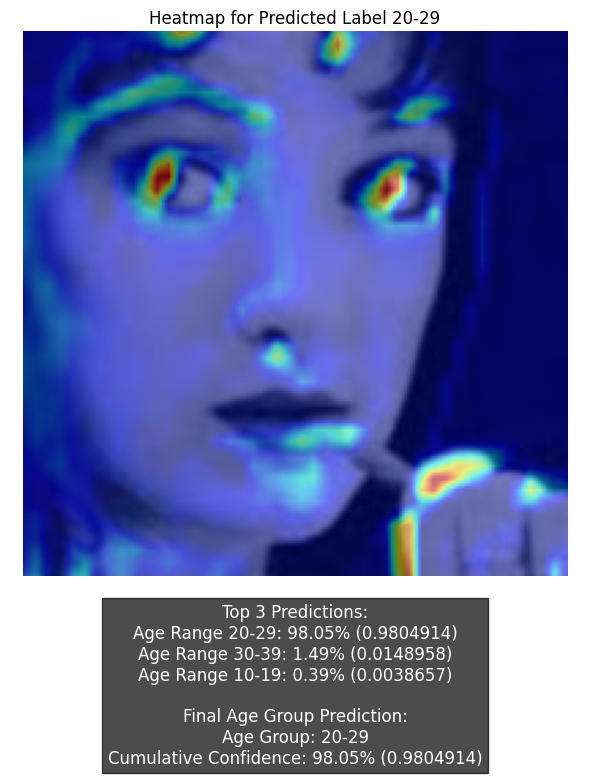

Top 3 Predictions:
Age Range 60-69: 34.56% (0.3456427)
Age Range 50-59: 33.25% (0.3325167)
Age Range 70-79: 17.60% (0.1760327)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 92.18% (0.9217801)


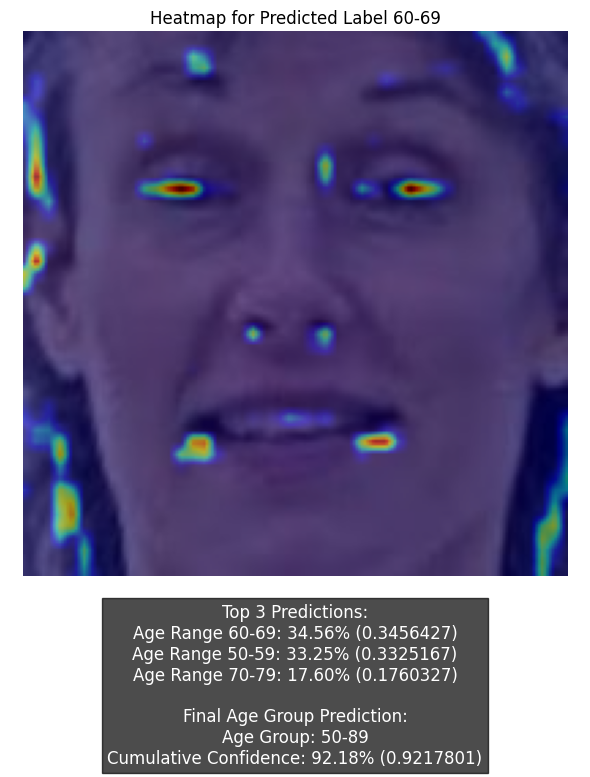

Top 3 Predictions:
Age Range 40-49: 49.58% (0.4957998)
Age Range 30-39: 37.59% (0.3758735)
Age Range 50-59: 9.11% (0.0911065)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 96.28% (0.9627798)


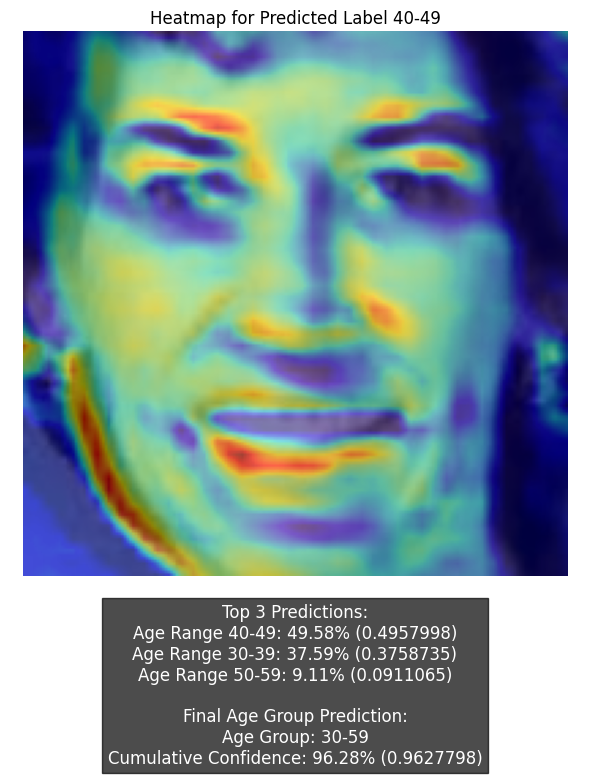

Top 3 Predictions:
Age Range 50-59: 31.63% (0.3162727)
Age Range 60-69: 31.00% (0.3100437)
Age Range 70-79: 17.59% (0.1758557)

Final Age Group Prediction:
Age Group: 40-89
Cumulative Confidence: 95.26% (0.9525743)


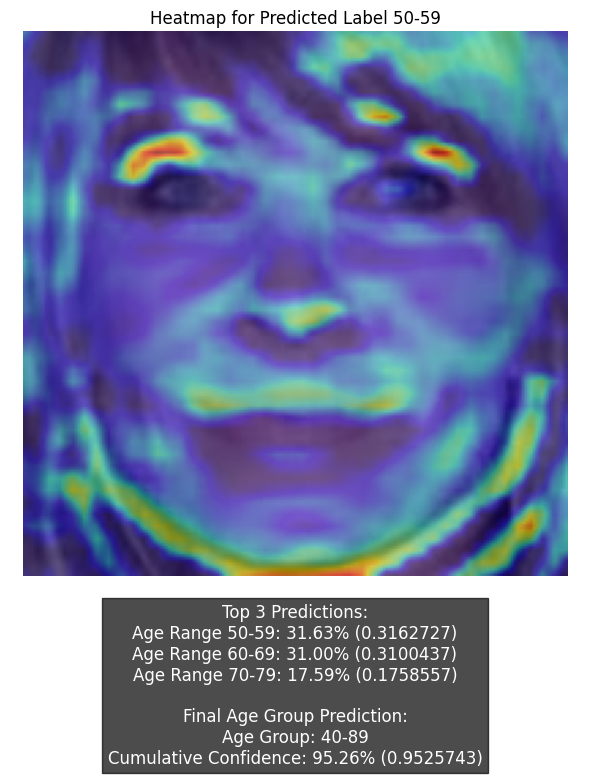

Top 3 Predictions:
Age Range 20-29: 82.64% (0.8264114)
Age Range 30-39: 13.05% (0.1305429)
Age Range 10-19: 2.22% (0.0221510)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 95.70% (0.9569542)


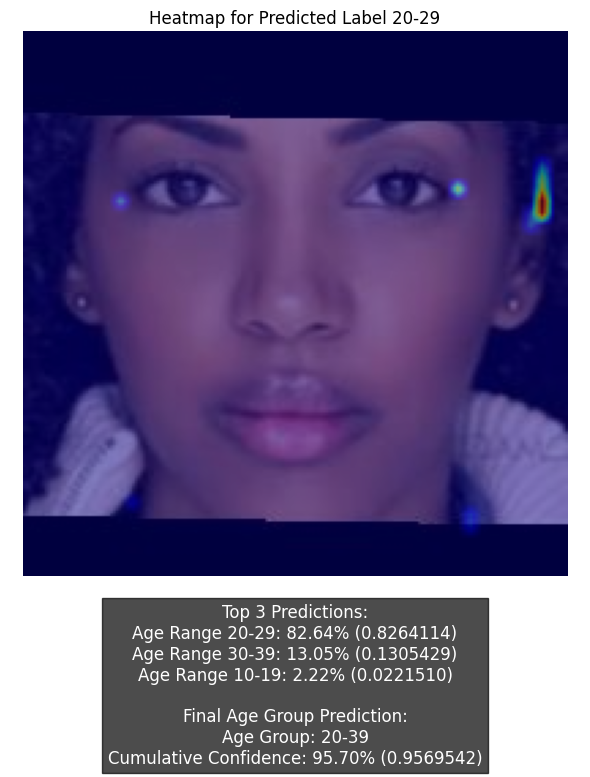

Top 3 Predictions:
Age Range 20-29: 48.23% (0.4822648)
Age Range 30-39: 28.67% (0.2866834)
Age Range 10-19: 8.34% (0.0833843)

Final Age Group Prediction:
Age Group: 10-49
Cumulative Confidence: 91.91% (0.9190812)


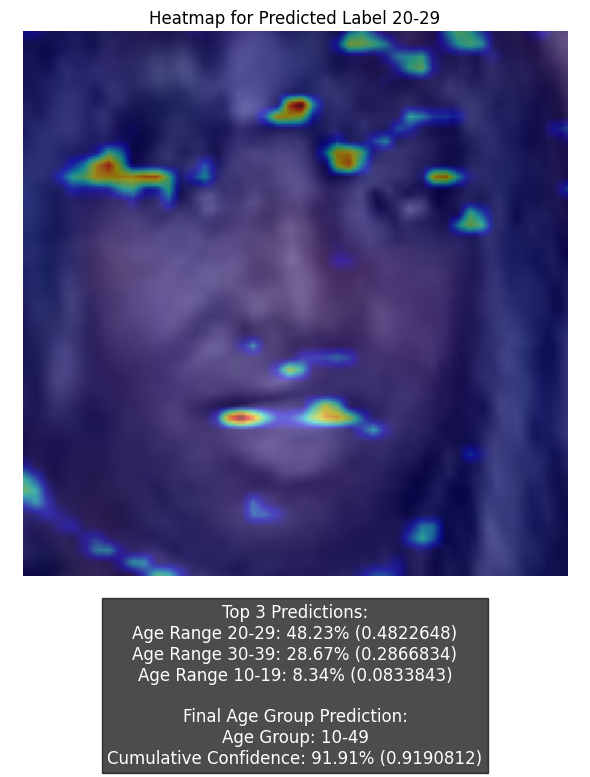

Top 3 Predictions:
Age Range 30-39: 41.49% (0.4148565)
Age Range 40-49: 33.12% (0.3312103)
Age Range 20-29: 12.04% (0.1204190)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 97.95% (0.9795280)


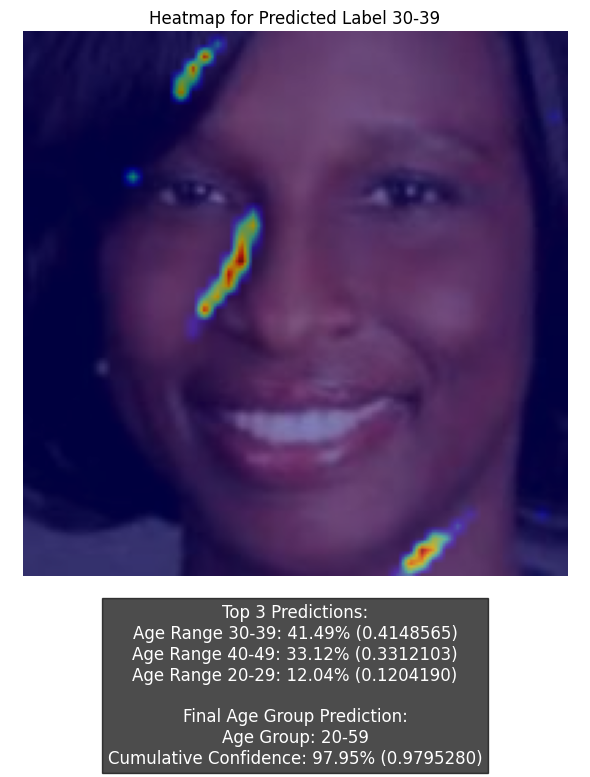

Top 3 Predictions:
Age Range 30-39: 28.97% (0.2897168)
Age Range 20-29: 27.39% (0.2738838)
Age Range 50-59: 11.04% (0.1103953)

Final Age Group Prediction:
Age Group: 0-69
Cumulative Confidence: 93.35% (0.9334643)


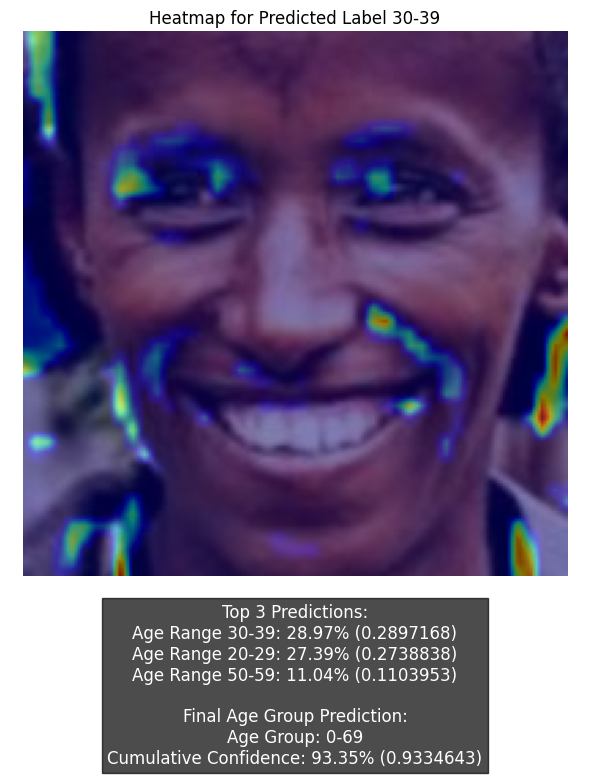

Top 3 Predictions:
Age Range 20-29: 98.62% (0.9862244)
Age Range 30-39: 1.04% (0.0103874)
Age Range 10-19: 0.32% (0.0032034)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 98.62% (0.9862244)


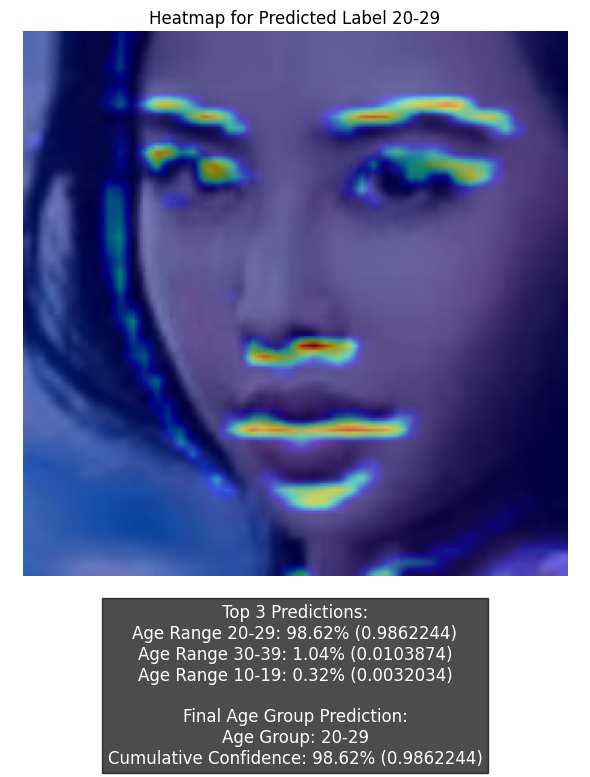

Top 3 Predictions:
Age Range 30-39: 49.42% (0.4942113)
Age Range 40-49: 23.83% (0.2382762)
Age Range 20-29: 16.74% (0.1673954)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 98.25% (0.9824682)


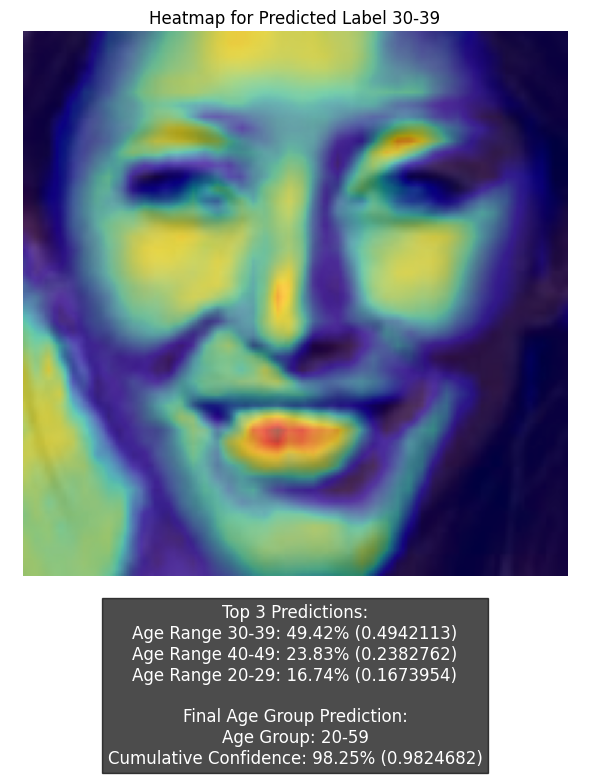

Top 3 Predictions:
Age Range 30-39: 38.19% (0.3818841)
Age Range 40-49: 23.99% (0.2399297)
Age Range 20-29: 20.11% (0.2010529)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 92.72% (0.9272137)


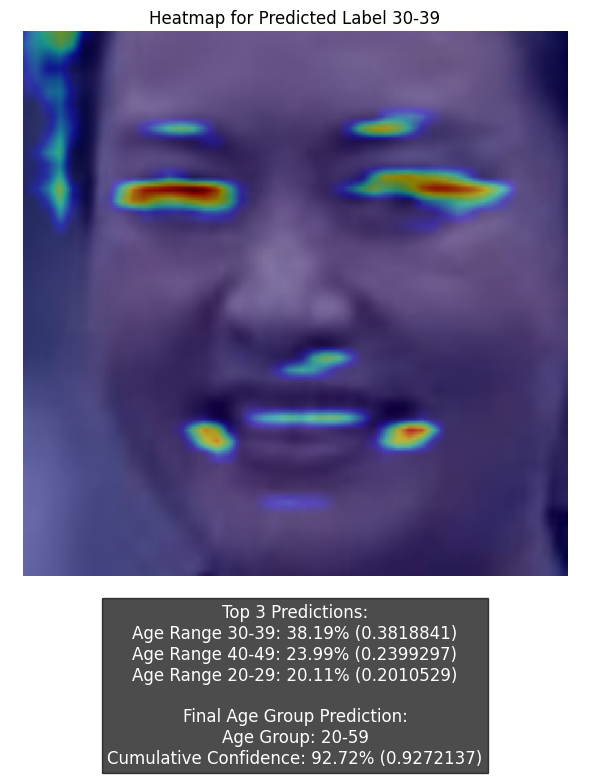

Top 3 Predictions:
Age Range 50-59: 29.58% (0.2957996)
Age Range 60-69: 22.10% (0.2209803)
Age Range 40-49: 15.76% (0.1576366)

Final Age Group Prediction:
Age Group: 30-89
Cumulative Confidence: 95.36% (0.9536448)


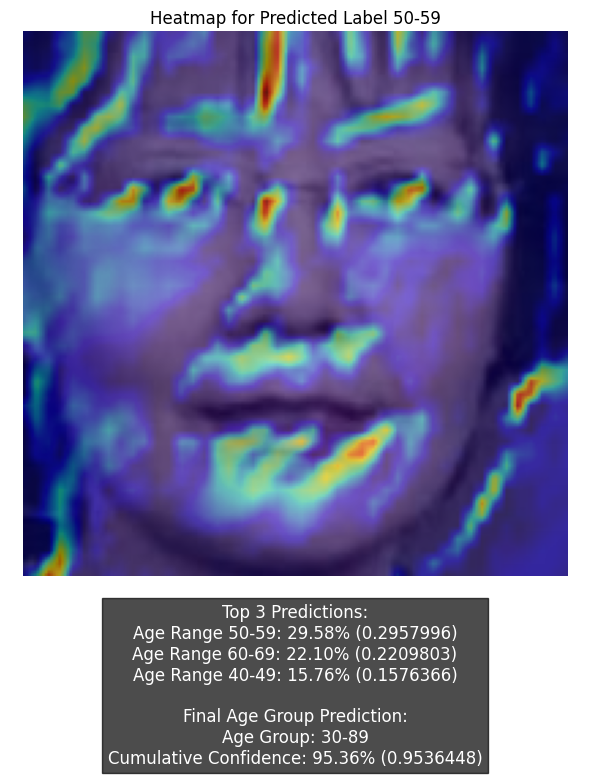

Top 3 Predictions:
Age Range 20-29: 95.79% (0.9578827)
Age Range 30-39: 3.85% (0.0385376)
Age Range 10-19: 0.31% (0.0030652)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 95.79% (0.9578827)


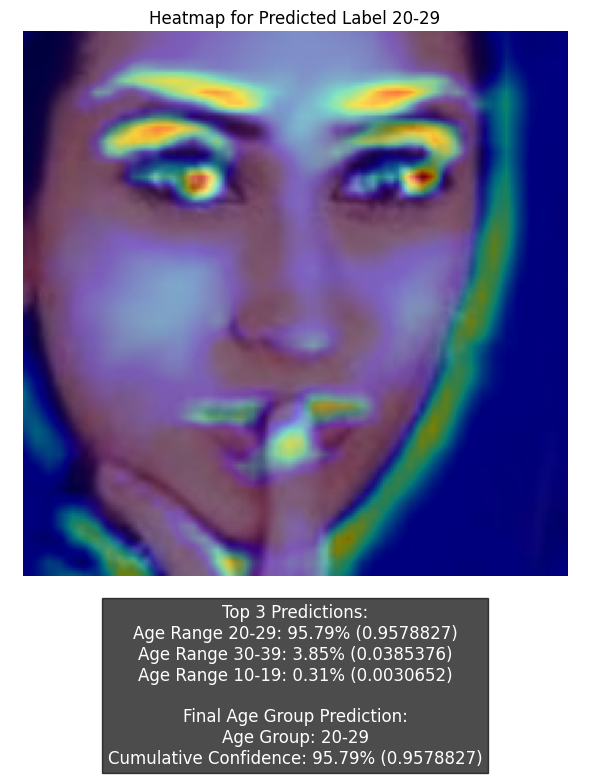

Top 3 Predictions:
Age Range 20-29: 45.35% (0.4535264)
Age Range 30-39: 22.92% (0.2292233)
Age Range 10-19: 17.50% (0.1750112)

Final Age Group Prediction:
Age Group: 10-49
Cumulative Confidence: 93.75% (0.9374544)


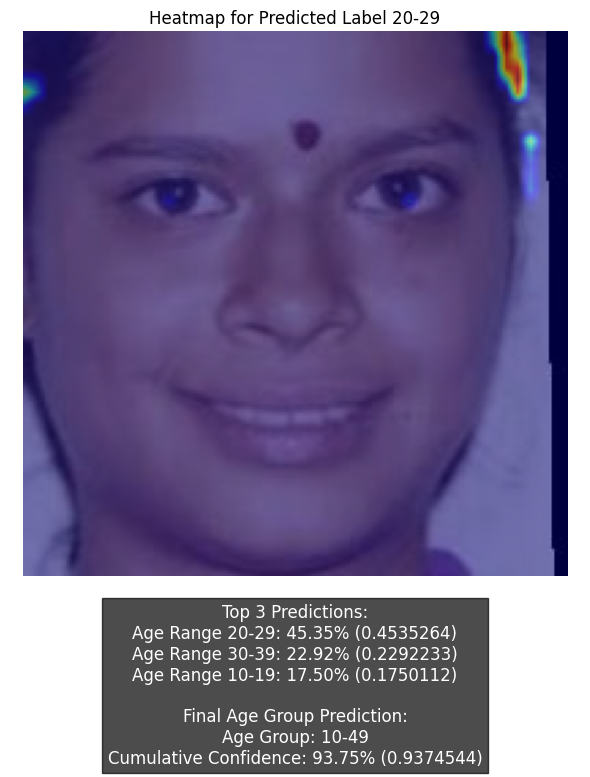

Top 3 Predictions:
Age Range 30-39: 41.68% (0.4167826)
Age Range 40-49: 31.15% (0.3115355)
Age Range 50-59: 13.84% (0.1383871)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 98.15% (0.9814717)


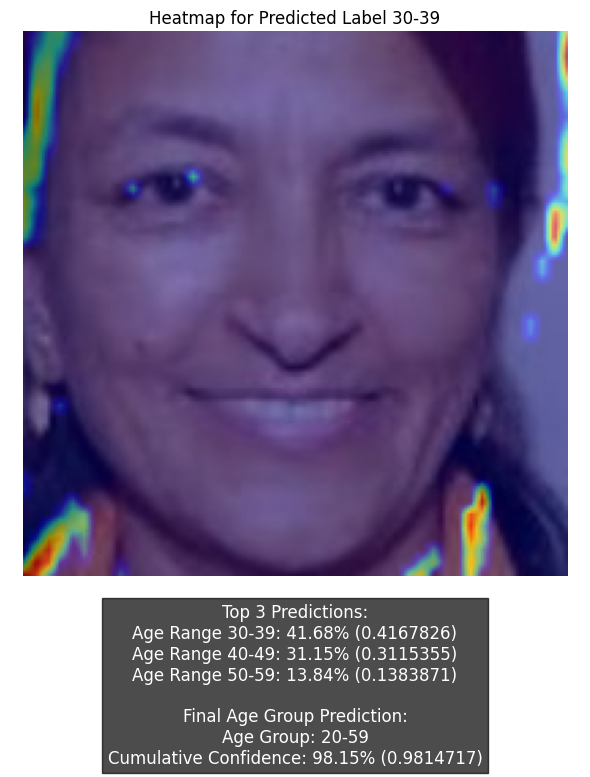

Top 3 Predictions:
Age Range 50-59: 31.64% (0.3164095)
Age Range 40-49: 28.80% (0.2879596)
Age Range 30-39: 20.34% (0.2034385)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 90.51% (0.9050552)


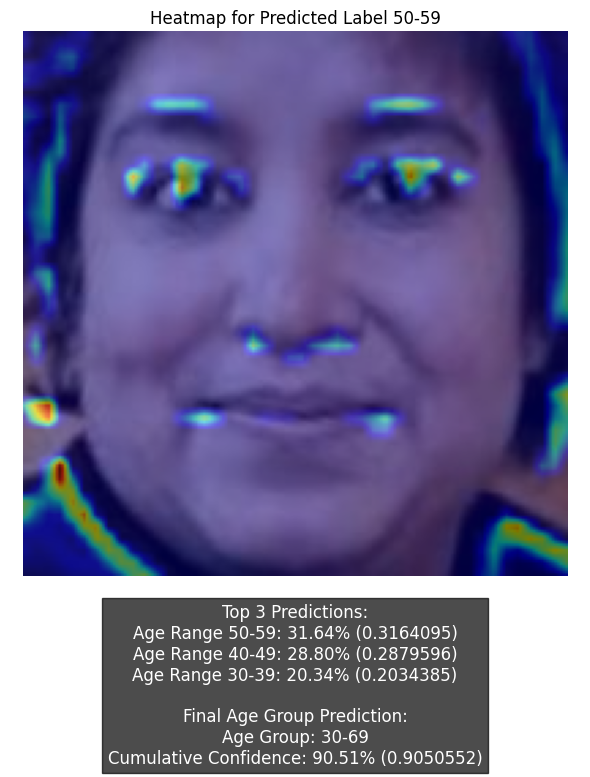

Top 3 Predictions:
Age Range 20-29: 84.13% (0.8413382)
Age Range 30-39: 10.29% (0.1028862)
Age Range 10-19: 4.23% (0.0422868)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 94.42% (0.9442244)


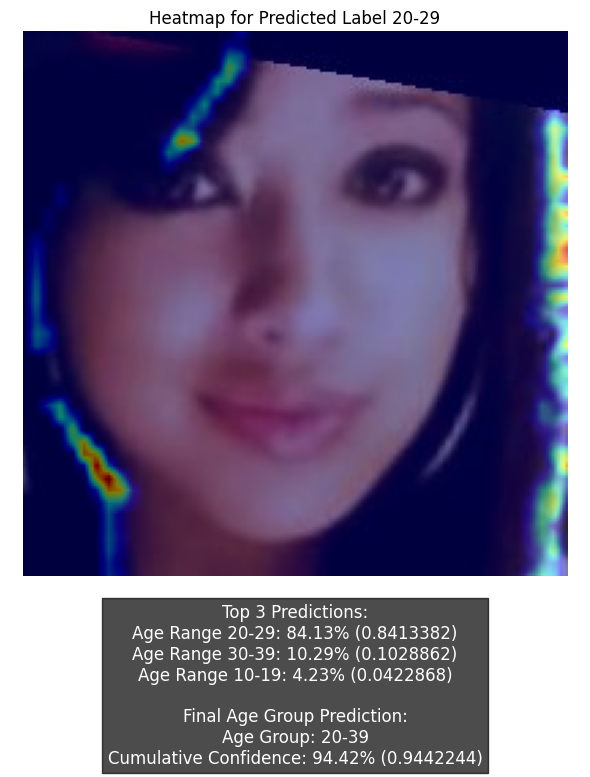

Top 3 Predictions:
Age Range 30-39: 37.91% (0.3790596)
Age Range 40-49: 24.95% (0.2495273)
Age Range 50-59: 17.82% (0.1782033)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 93.05% (0.9305222)


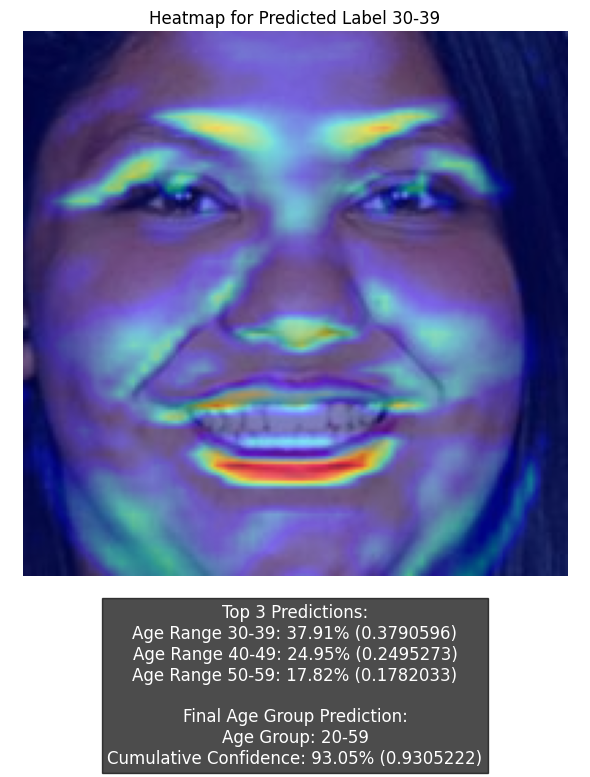

Top 3 Predictions:
Age Range 30-39: 34.75% (0.3475146)
Age Range 40-49: 21.71% (0.2171401)
Age Range 20-29: 21.41% (0.2141303)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 90.46% (0.9045590)


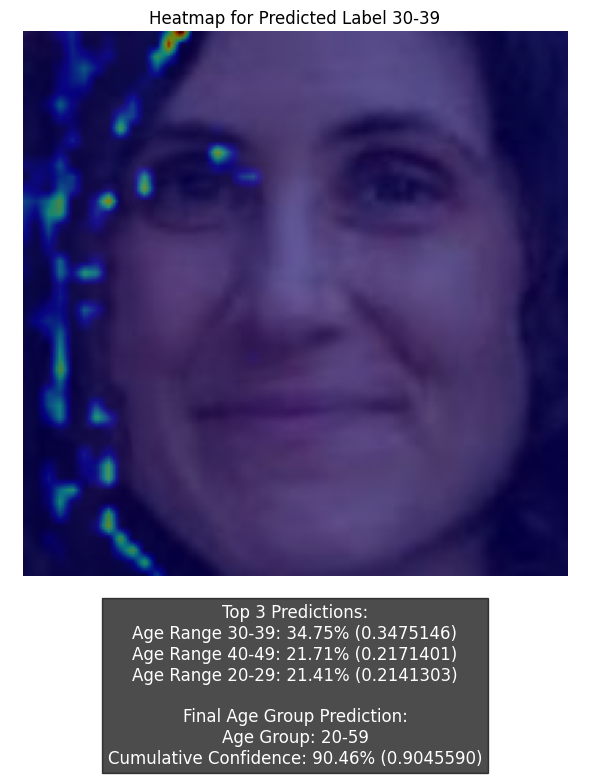

Top 3 Predictions:
Age Range 30-39: 35.52% (0.3551840)
Age Range 20-29: 29.89% (0.2989269)
Age Range 40-49: 14.69% (0.1469419)

Final Age Group Prediction:
Age Group: 10-59
Cumulative Confidence: 93.55% (0.9354835)


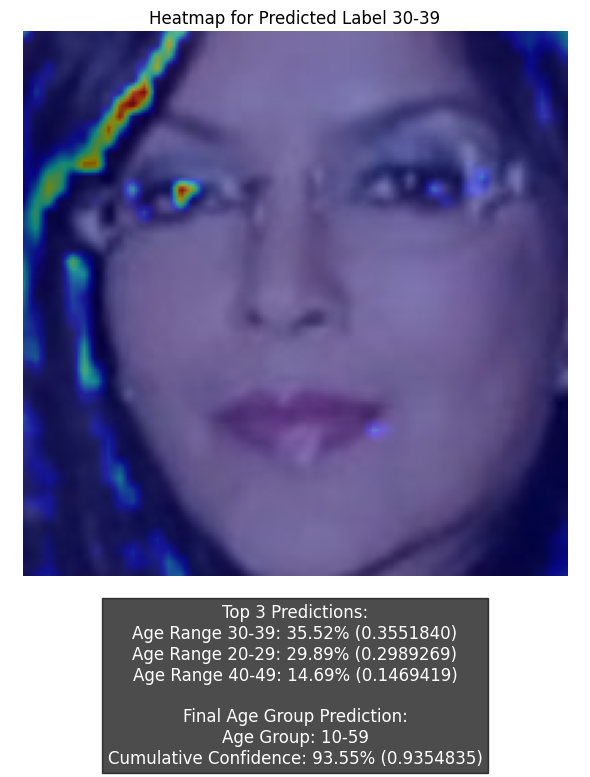

In [93]:
df_to_process_balanced = pd.read_csv('balanced_model_prototypes_and_criticisms.csv')

for index, row in df_to_process_balanced.iterrows():
    prototype_image_path = row['Prototype_Image_Path']
    criticism_image_path = row['Criticism_Image_Path']
    
    prototype_save_file = f"images/prototypes_and_criticisms/balanced_heatmap_prototype_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    criticism_save_file = f"images/prototypes_and_criticisms/balanced_heatmap_criticism_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    
    predict_xai(base_model, prototype_image_path, plot_heatmap=True, save_file=prototype_save_file)
    predict_xai(base_model, criticism_image_path, plot_heatmap=True, save_file=criticism_save_file)